In [27]:
import pygot
import scvi
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import torch
import random
import scipy
from rich import print

import warnings
from lightning_fabric.plugins.environments.slurm import PossibleUserWarning
warnings.simplefilter(action='ignore', category=PossibleUserWarning)
warnings.simplefilter(action='ignore', category=UserWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

scvi.settings.seed = 42
random.seed(42)
np.random.seed(42)
%matplotlib inline

Seed set to 42


In [28]:

plt.rcParams['font.sans-serif'] = ['Arial']

## Helper Function

In [29]:
# 2022 TOME definition

file = open("../pygot_data/TOME/tome_code/help_code/mouse_celltype_group.txt")
i = 1
fx_map = {}
cell_type_classification = {'Unknown':'Unknown'}
for line in file:
    l = line.rstrip().split("\t")
    cell_type_classification[l[0]] = int(l[1])
    fx_map[l[0]] = i
    i += 1


file.close()
fx_map['ICM'] = 97
fx_map['16C'] = 98
fx_map['8C'] = 98
fx_map['4C'] = 98
fx_map['2C'] = 98
fx_map['Zygote'] = 98
fx_map['Primitive endoderm'] = 100
fx_map['Unknown'] = 0
cell_type_classification['Zygote'] = 0
cell_type_classification['2C'] = 0
cell_type_classification['4C'] = 0
cell_type_classification['8C'] = 0
cell_type_classification['16C'] = 0
cell_type_classification['ICM'] = 0
cell_type_classification['Trophectoderm'] = 0
cell_type_classification['Primitive endoderm'] = 0

In [30]:
def summary_road_map(back_state_coupling_list, processed_state_dist_list, ts, cutoff=0.):
    cell_type_class_names = ['Other', 'Neuroectoderm', 'Surface ectoderm', 'Endoderm', 'Mesoderm', 'ExE embryo']
    def process(state_coupling, traj_dist_coupling, i):
        df = state_coupling.copy()
        df.index = df.index.to_series().apply(lambda x: 'E'+str(ts[i])+':'+x)
        df.columns = df.columns.to_series().apply(lambda x: 'E'+str(ts[i+1])+':'+x)
        df = pd.DataFrame(df.stack()).reset_index()
        if traj_dist_coupling is None:
            traj_dist = 0.
        else:
            traj_dist = pd.DataFrame(traj_dist_coupling.fillna(0).stack()).reset_index()[0]
        df.columns = ['from', 'to', 'weight']
        df['dist'] = traj_dist
        df = df.loc[df['weight'] > cutoff]
        
        return df
    all_df = []
    for i in range(len(ts) - 1):
        if processed_state_dist_list is None:
            all_df.append(process(back_state_coupling_list[i], None, i))
        else:
            all_df.append(process(back_state_coupling_list[i], processed_state_dist_list[i], i))
    summary = pd.concat(all_df).reset_index(drop=True)
    
    node_profile = pd.DataFrame(np.unique(list(summary['from']) + list(summary['to'])), columns=['name'])
    node_profile['group'] = node_profile['name'].apply(lambda x: cell_type_class_names[cell_type_classification[x.split(':')[1]]])
    node_profile['position'] = node_profile['name'].apply(lambda x: fx_map[x.split(':')[1]])
    node_profile['cell_state'] = node_profile['name'].apply(lambda x: x.split(':')[1])
    node_profile['stage'] = node_profile['name'].apply(lambda x: float(x.split(':')[0][1:]))

    return summary, node_profile




In [32]:


def state2cell_type(x):
    if x.endswith('Unknown'):
        return 'Unknown'
    return state2type_map[x]


def state2cell_type(x):
    if x.endswith('Unknown'):
        return 'Unknown'
    return x
### 11. group of celltypes. 1: neuroectoderm; 2: surface ectoderm; 3: endoderm; 4: mesoderm; 5: exe germ layer; 0: other
### 1: green, 2: blue, 3: red; 4: yellow; 5: brown; 0: black
class_colors = {1:"#145A32",2:"#78281F",3:"#9A7D0A",4:"#2471A3",5:"#E67E22",0:"#000000", 'Unknown': '#cccccc'}    
def coupling2link(state_coupling_list, curr, x, cutoff=0.2, state_dist_list=None):
    #print(curr, x)
    if curr >= len(state_coupling_list):
        return []
    state_coupling = state_coupling_list[curr]
    tree_dict = []
    anc_cell_type = state2cell_type(x)
    for j, y in enumerate(state_coupling.columns):
        try:
            val = state_coupling.loc[x,y]
        except:
            print(curr, x, y)
        
        if val > cutoff:
            cell_type = state2cell_type(y)
            item = {"name": cell_type, "children":coupling2link(state_coupling_list, curr+1, y, cutoff=cutoff, state_dist_list=state_dist_list),
                   "edge_weight": val if (cell_type != 'Unknown' and anc_cell_type != 'Unknown') else 0.,
                   "fx": str(fx_map[cell_type]),
                    "edge_color": 0. if (state_dist_list is None) else state_dist_list[curr].loc[x, y],
                    "node_group": class_colors[cell_type_classification[cell_type]]}
            if len(item['children']) == 0:
                del item['children']
            tree_dict.append(item)

    return tree_dict

def add_unknown_anc(coupling, cutoff=0.2):
    stage = coupling.index[0].split(':')[0]
    next_stage = coupling.columns[0].split(':')[0]
    coupling[next_stage+':Unknown'] = 0
    candidate = coupling.columns[coupling.apply(lambda x: x.max() < cutoff)]
    add_unknown = []
    for item in candidate:
        c = state2cell_type(item)
        ac_c =  coupling.index.str.endswith(c)
        if sum(ac_c) > 0:
            coupling.loc[ac_c, item] = 1.
        else:
            add_unknown.append(item)
    coupling.loc[stage+':Unknown'] = 0
    coupling.loc[stage+':Unknown', add_unknown] = cutoff+1e-6
    #coupling.loc[stage+'_Unknown', next_stage+'_Unknown'] = 0.21
    return coupling

In [33]:
def get_tree_data(state_coupling_list, cutoff=0.2, state_dist_list=None):
    tree_dict = []
    for i, x in enumerate(state_coupling_list[0].index):
        cell_type = state2cell_type(x)
        
        tree_dict.append({"name": cell_type, "children":coupling2link(state_coupling_list, 0, x, cutoff, state_dist_list), 
                          "edge_weight":1. if cell_type != 'Unknown' else 0.,
                         "fx": str(fx_map[cell_type]),
                          "edge_color":0.,
                "node_group": class_colors[cell_type_classification[cell_type]]})
    tree_data = {
      "name": "Root",
      "children": tree_dict,
        "fx": "1",
        "node_group": "#000000"
    }
    return tree_data

d3_code_template = """
// 创建树状结构数据
var treeData = [
{{data}}
];


// ************** Generate the tree diagram  *****************
var margin = {top: 20, right: 20, bottom: 20, left: 20},
 width = 2000 - margin.right - margin.left,
 height = 1500 - margin.top - margin.bottom;
 
var i = 0;

var tree = d3.layout.tree()
 .size([height, width]);

var diagonal = d3.svg.diagonal()
 .projection(function(d) { return [d.y, d.x]; });

var svg = d3.select("body").append("svg")
 .attr("width", width + margin.right + margin.left)
 .attr("height", height + margin.top + margin.bottom)
  .append("g")
 .attr("transform", "translate(" + margin.left + "," + margin.top + ")");

root = treeData[0];
  
update(root);

function update(source) {

   
  // 过滤掉名字为 "Unknown" 的节点
  var nodes = tree.nodes(root).reverse().filter(function(d) {
    return d.name !== "Unknown";
  });

  // Compute the new tree layout.
  // var nodes = tree.nodes(root).reverse(),
  links = tree.links(nodes);

  // Normalize for fixed-depth.
  nodes.forEach(function(d) { d.y = d.depth * 80; });

  nodes.forEach(function(d) { d.x = d.fx * 12; });

  

  // Declare the nodes
  var node = svg.selectAll("g.node")
   .data(nodes, function(d) { return d.id || (d.id = ++i); });

  // Enter the nodes.
  var nodeEnter = node.enter().append("g")
    .attr("class", "node")
    .attr("transform", function(d) { return "translate(" + d.y + "," + d.x + ")"; });
    
  
  nodeEnter.append("circle")
   .attr("r", 2)
   .style("fill", function(d){return d.node_group})
   .style("stroke", function(d){return d.node_group});

  // 仅显示需要标记的节点名称
  nodeEnter.append("text")
  .attr("dx", 5)
  .attr("dy", "1.5em")
  .style("font-size", "5px")
  .text(function(d) { return d.name; });

  // Declare the links
  var link = svg.selectAll("path.link")
   .data(links, function(d) { return d.target.id; });
    
  // Enter the links.
  
  var color = function(t) {
  t = Math.max(0, Math.min(1, t));
  return "rgb("
      + Math.max(0, Math.min(255, Math.round(34.61 + t * (1172.33 - t * (10793.56 - t * (33300.12 - t * (38394.49 - t * 14825.05))))))) + ", "
      + Math.max(0, Math.min(255, Math.round(23.31 + t * (557.33 + t * (1225.33 - t * (3574.96 - t * (1073.77 + t * 707.56))))))) + ", "
      + Math.max(0, Math.min(255, Math.round(27.2 + t * (3211.1 - t * (15327.97 - t * (27814 - t * (22569.18 - t * 6838.66)))))))
      + ")";
  };

  link.enter().insert("path", "g")
   .attr("class", "link")
   .attr("d", diagonal)
   .attr("opacity", function(d){
        return d.target.edge_weight;})
   .attr("stroke-width", function(d){
        return (1.- d.target.edge_color) * 3;});
   // .style("stroke", function(d){
   //               return color(d.target.edge_color);});        
        
}
"""
html_template = """<!DOCTYPE html>
<html lang="en">
  <head>
    <meta charset="utf-8">

    <title>Collapsible Tree Example</title>

    <style>

 .node circle {
   fill: #000000;
   stroke: #000000;
   stroke-width: 5px;
 }

 .node text { font: 12px sans-serif; }

 .link {
   fill: none;
   stroke: #000000;
   // stroke-width: 2.5px;
 }
 
    </style>

  </head>

  <body>

<!-- load the d3.js library --> 
<script src="http://d3js.org/d3.v3.min.js"></script>

<script>
// replace d3.js code
</script>
 
  </body>
</html>


"""


## Preprocess adata

In [19]:
adata = sc.read('../pygot_data/development/01_mouse_reprocessed.h5ad')

In [20]:
adata_2 = sc.read('../pygot_data/TOME/E3.5_E8.5a.h5ad')

Only considering the two last: ['.5a', '.h5ad'].
Only considering the two last: ['.5a', '.h5ad'].


In [21]:
batch_map = {
    'E3.5':'Mohammed',
    'E4.5':'Mohammed',
    'E5.25':'Cheng',
    'E5.5':'Mohammed',
    'E6.25':'Cheng',
    'E6.5':'Sala',
    'E6.75':'Sala',
    'E7':'Sala',
    'E7.25':'Sala',
    'E7.5':'Sala',
    'E7.75':'Sala',
    'E8':'Sala',
    'E8.25':'Sala',
    'E8.5a':'Sala',
}

adata_2.obs['batch'] = adata_2.obs['day'].replace(batch_map)
adata_2.obs.loc[adata_2.obs['sample'].str.startswith('E6.5'), 'batch'] = 'Mohammed'
adata_2.obs.loc[adata_2.obs['orig.ident'] == 'EB', 'batch'] = 'Cheng'
adata_2.obs['batch']

E3.5_P8_Cell2_embryo1_single     Mohammed
E3.5_P8_Cell3_embryo2_single     Mohammed
E3.5_P8_Cell5_embryo3_single     Mohammed
E3.5_P8_Cell7_embryo4_single     Mohammed
E3.5_P8_Cell22_embryo5_single    Mohammed
                                   ...   
cell_139326                          Sala
cell_139327                          Sala
cell_139329                          Sala
cell_139330                          Sala
cell_139331                          Sala
Name: batch, Length: 111090, dtype: category
Categories (3, object): ['Mohammed', 'Cheng', 'Sala']

In [22]:
adata_2 = adata_2[~adata_2.obs['day'].isin(['E3.5', 'E4.5'])]

In [23]:
adata_2.obs['technology'] = '10X'
adata_2.obs.loc[adata_2.obs['batch'] != 'Sala', 'technology'] = 'SMART-seq2'
adata_2.obs['LenNorm'] = False
adata_2.obs.loc[adata_2.obs['batch'] != 'Sala', 'LenNorm'] = True
adata.obs['LenNorm'] = False

In [24]:
adata_2.obs['experiment'] = adata_2.obs['batch']
adata_2.obs['timepoint'] = adata_2.obs['day']
adata.obs['cell_state'] = adata.obs['ct']
adata.X = adata.layers['counts']

In [8]:
meta = sc.read('../pygot_data/Perturbation/mouse/preprocessed_mouse-gastrulation-atlas.h5ad').obs
adata_2.obs['sample'] = '0'
adata_2.obs.loc[meta.index.intersection(adata_2.obs.index), 'sample'] = meta.loc[meta.index.intersection(adata_2.obs.index)]['sample'].astype(str)


In [9]:
adata_2.obs['batch'] = adata_2.obs.apply(lambda x: x['experiment'] + ':' + x['sample'], axis=1)

## Normalize SMART-tech

In [25]:
genes_length = pd.read_table("../pygot_data/TOME/tome_code/help_code/mouse.v12.geneID.txt").set_index('gene_ID')
genes_length['length'] = genes_length['end'] - genes_length['start']
genes_length

,chr,start,end,strand,gene_type,gene_short_name,length
gene_ID,,,,,,,
ENSMUSG00000102693,chr1,3073253,3074322,+,TEC,4933401J01Rik,1069
ENSMUSG00000064842,chr1,3102016,3102125,+,snRNA,Gm26206,109
ENSMUSG00000051951,chr1,3205901,3671498,-,protein_coding,Xkr4,465597
ENSMUSG00000102851,chr1,3252757,3253236,+,processed_pseudogene,Gm18956,479
ENSMUSG00000103377,chr1,3365731,3368549,-,TEC,Gm37180,2818
...,...,...,...,...,...,...,...
ENSMUSG00000111038,KK082441.1,254524,255539,-,pseudogene,CR936839.3,1015
ENSMUSG00000111855,KK082441.1,257717,258330,+,pseudogene,CR936839.4,613
ENSMUSG00000102161,KK082441.1,287073,287308,-,processed_pseudogene,RP23-146J17.3,235


In [26]:
#genes_length = pd.read_table("/disk/xuruihong/GenomeDir/mm10/GRCm38.92_gene_len.txt").set_index('gene')
#genes_length['length'] = genes_length['mean']
#genes_length

def normalize_smartseq(adata: sc.AnnData, gene_len: pd.DataFrame) -> sc.AnnData:
    print("SMART-SEQ: Normalization")

    common_genes = adata.var_names.intersection(gene_len.index)
    print(f"SMART-SEQ: Common genes {common_genes.shape[0]}")

    lengths = gene_len.loc[common_genes, "length"].values
    normalized = adata[:, common_genes].copy()
    normalized.X = normalized.X / lengths * np.median(lengths)
    normalized.X = np.rint(normalized.X)

    return normalized

from scipy.sparse import csr_matrix
def partial_norm(adata_2):
    norm_len_adata = adata_2[adata_2.obs['LenNorm'] == True].copy()
    adata_2 = adata_2[adata_2.obs['LenNorm'] == False]
    normed_len_adata = normalize_smartseq(norm_len_adata, genes_length)
    norm_len_adata.var['idx'] = range(len(norm_len_adata.var))
    norm_gene_idx = norm_len_adata.var.loc[normed_len_adata.var.index]['idx'].tolist()
    
    X = norm_len_adata.X.toarray()
    X[:, norm_gene_idx] = normed_len_adata.X.toarray()
    norm_len_adata.X = csr_matrix(X)
    adata_2 = sc.concat([norm_len_adata,adata_2] )
    return adata_2

In [27]:
adata_2 = partial_norm(adata_2)
adata_2.layers['counts'] = adata_2.X.copy()

SMART-SEQ: Normalization

SMART-SEQ: Common genes 30543

In [28]:
adata.var = adata.var.set_index('gene_ids')

In [29]:
adata = sc.concat([adata, adata_2])

In [30]:
stage_numeric = {
    'Zygote': 'E0.5',
    '2C': 'E1.5',
    '4C': 'E2.0',
    '8C': 'E2.5',
    '16C': 'E3.0',
    'E8.5a': 'E8.5'
}
adata.obs['stage_numeric'] = adata.obs['timepoint'].replace(stage_numeric).astype(str)
adata.obs['stage_numeric'] = adata.obs['stage_numeric'].apply(lambda x :  float(x[1:]))

In [31]:
adata = adata[adata.obs['stage_numeric'] != 3.75]
adata.obs['cell_type'] = np.nan
adata.obs.loc[adata_2.obs.index, 'cell_type'] = adata_2.obs['cell_type']
adata.obs['cell_state'] = adata.obs['cell_state'].astype(str)
idx = (~adata.obs['cell_state'].str.contains(':')) & (adata.obs['cell_state'].str.contains('-'))
adata.obs.loc[idx, 'cell_state'] = adata.obs.loc[idx]['cell_state'].astype(str).apply(lambda x: x.split('-')[0] + ':' + x.split('-')[1])
idx = (~adata.obs['cell_state'].str.contains(':'))
adata.obs.loc[idx, 'cell_state'] = adata.obs.loc[idx].apply(lambda x: 'E'+str(x.stage_numeric)+':'+x.cell_state, axis=1)
idx = adata.obs['cell_type'] != adata.obs['cell_type']
adata.obs.loc[idx, 'cell_type'] = adata.obs.loc[idx]['cell_state'].apply(lambda x: x.split(':')[1])

In [90]:
E0_5_E6_5_adata = adata[adata.obs['stage_numeric'] <= 6.5 ].copy()
E0_5_E6_5_adata = E0_5_E6_5_adata[(E0_5_E6_5_adata.obs['stage_numeric'] != 6.5) | (E0_5_E6_5_adata.obs['batch'].str.startswith('Sala') & (E0_5_E6_5_adata.obs['stage_numeric'] == 6.5))]
#E6_5_E8_5_adata = adata[(adata.obs['stage_numeric'] >= 6.5) & (adata.obs['batch'].str.startswith('Sala'))].copy()

In [92]:
E0_5_E6_5_adata.raw = E0_5_E6_5_adata.copy()
sc.pp.normalize_total(E0_5_E6_5_adata)
sc.pp.log1p(E0_5_E6_5_adata)

In [93]:
sc.pp.highly_variable_genes(
    E0_5_E6_5_adata,
    flavor="cell_ranger",
    n_top_genes=3_000,
    # batch_key="batch",
    batch_key="experiment",
    #layer='counts',
    subset=True,
)

... storing 'technology' as categorical
... storing 'cell_state' as categorical
... storing 'cell_type' as categorical


In [94]:
sc.write('../pygot_data/development/E0_5_6_5/adata_raw.h5ad', E0_5_E6_5_adata)

In [55]:
E6_5_E8_5_adata = adata[(adata.obs['stage_numeric'] >= 6.5) & (adata.obs['batch'].str.startswith('Sala'))].copy()

In [56]:
E6_5_E8_5_adata.raw = E6_5_E8_5_adata
sc.pp.normalize_total(E6_5_E8_5_adata)
sc.pp.log1p(E6_5_E8_5_adata)

sc.pp.highly_variable_genes(
    E6_5_E8_5_adata,
    flavor="cell_ranger",
    n_top_genes=3000,
    subset=True,
)

In [57]:
sc.write('../pygot_data/development/E6_5_8_5/adata_raw.h5ad', E6_5_E8_5_adata)

## Integration

In [670]:
def scvi_scanvi_pipeline(ad, batch_key='batch', linear=False):
    try:
        ad.layers['counts'] = ad.layers['counts'].toarray()
    except:
        print('already dense')
    if linear:
        scvi.model.LinearSCVI.setup_anndata(
            ad, 
            layer="counts", 
            batch_key=batch_key,
        )
        vae = scvi.model.LinearSCVI(ad, n_layers=2, n_latent=50, gene_likelihood='nb')
    else:    
        scvi.model.SCVI.setup_anndata(
            ad, 
            layer="counts", 
            batch_key=batch_key,
        )
    
    
        vae = scvi.model.SCVI(ad, n_layers=2, n_latent=30, gene_likelihood='nb')
    vae.train( max_epochs=250, early_stopping=True)
    pd.concat([vae.history['elbo_train'], vae.history['elbo_validation']], axis=1).plot.line(marker='o')
    ad.obsm["X_scVI"] = vae.get_latent_representation(ad)
    sc.pp.neighbors(ad, use_rep='X_scVI', n_neighbors=50)
    sc.tl.umap(ad, min_dist=0.3)
    
    ad.obs['cell_type'] = ad.obs['cell_type'].astype(str).replace({
        'PrE': 'Hypoblast',
        'TE': 'Trophectoderm',
        'EPI': 'Epiblast',
        'ICM': 'Inner cell mass',
    })
    
    sc.pl.umap(ad, color=['experiment','batch',  'timepoint' ,'cell_type', 'stage_numeric'], ncols=1, cmap='Spectral_r')
    '''
    ad.obsm['X_scVI_umap'] = ad.obsm['X_umap']
    lvae = scvi.model.SCANVI.from_scvi_model(
        vae,
        adata=ad,
        labels_key="cell_type",
        unlabeled_category="Unknown",
    )
    lvae.train(max_epochs=15)
    ad.obsm["X_scANVI"] = lvae.get_latent_representation(ad)
    sc.pp.neighbors(ad, use_rep='X_scANVI', n_neighbors=50) 
    sc.tl.umap(ad, min_dist=0.3)

    sc.pl.umap(ad, color=['experiment','batch',  'timepoint' ,'cell_type', 'stage_numeric'], ncols=1, cmap='Spectral_r')
    '''
    return vae

### E0.5-E6.5

In [3]:
ad = sc.read('../pygot_data/development/E0_5_6_5/adata_raw.h5ad')

In [26]:
ad.obs.loc[ad.obs.stage_numeric == 6.5].experiment.unique().tolist()

['Sala']

In [698]:
ad.obs.loc[ad.obs['experiment'] == 'Mohammed', 'experiment'] = 'Mohammed et al., 2017'


In [699]:
ad.obs['batch'] = ad.obs['batch'].astype(str)
ad.obs.loc[ad.obs['batch'] == 'Cheng', 'batch'] = ad.obs.loc[ad.obs['batch'] == 'Cheng'].apply(lambda x: x['batch'] + '_' + x['timepoint'], axis=1)
sala_meta = meta = sc.read('../pygot_data/development/E6_5_8_5/adata_origin.h5ad').obs
ad.obs.loc[ad.obs.index.intersection(sala_meta.index), 'batch'] = sala_meta.loc[ad.obs.index.intersection(sala_meta.index)]['sample'].astype(str)
ad.obs.loc[ad.obs.index.intersection(sala_meta.index), 'batch'] = ad.obs.loc[ad.obs.index.intersection(sala_meta.index)]['batch'].apply(lambda x: 'Sala_'+x)

In [705]:
holdout_ad = ad[(ad.obs['timepoint'] == '16C') & (ad.obs['experiment'] == 'Deng et al., 2014')]

In [706]:
ad = ad[~((ad.obs['timepoint'] == '16C') & (ad.obs['experiment'] == 'Deng et al., 2014'))]

In [707]:
ad.obs['timepoint'].value_counts()

timepoint
E6.5      3484
E3.5       995
E5.5       464
E4.5       343
E5.25      331
E6.25      321
16C        140
8C         115
4C         114
E3.25       87
2C          86
Zygote      18
Name: count, dtype: int64

2025-01-16 10:41:36,498 - INFO - GPU available: True (cuda), used: True
2025-01-16 10:41:36,499 - INFO - TPU available: False, using: 0 TPU cores
2025-01-16 10:41:36,500 - INFO - HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Training:   0%|          | 0/250 [00:00<?, ?it/s]

2025-01-16 10:45:03,653 - INFO - `Trainer.fit` stopped: `max_epochs=250` reached.


Monitored metric elbo_validation did not improve in the last 45 records. Best score: 3343.811. Signaling Trainer to stop.


... storing 'batch' as categorical
... storing 'cell_type' as categorical


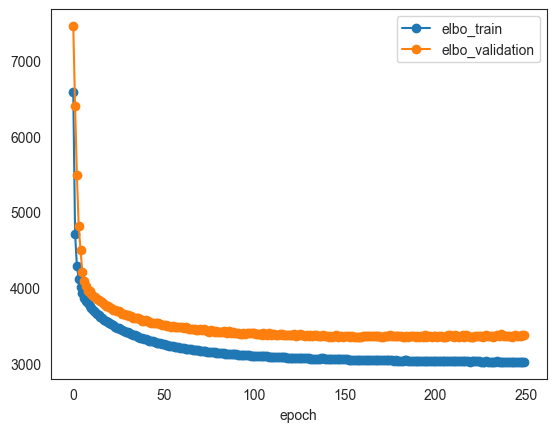

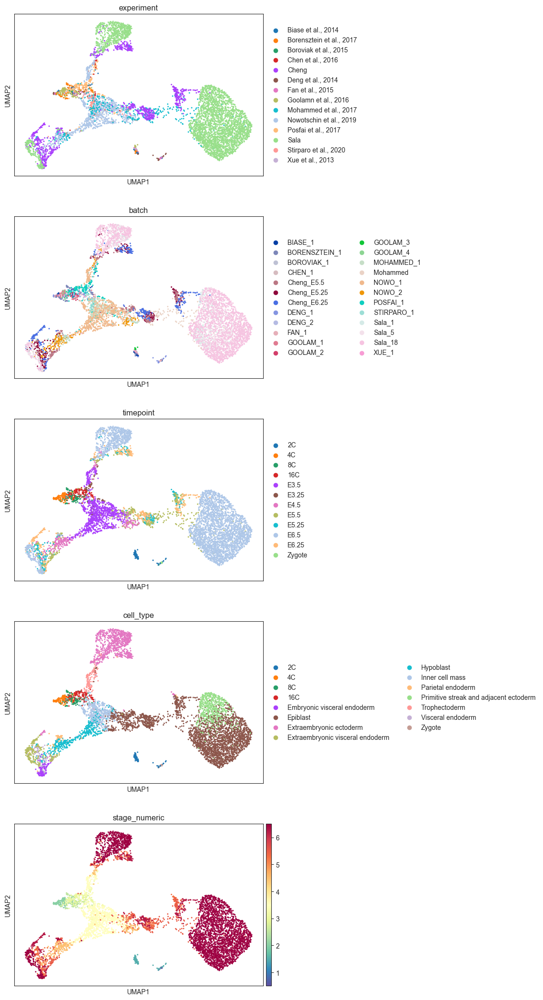

In [708]:
vae = scvi_scanvi_pipeline(ad)

In [47]:
#lvae.save('../pygot_data/development/E0_5_6_5/scanvi_model', overwrite=True)
vae.save('../pygot_data/development/E0_5_6_5/scvi_model', overwrite=True)

In [ ]:
ad.obs['time_label'] = ad.obs['stage_numeric'].replace(dict(zip(np.sort(np.unique(ad.obs.stage_numeric)), range(len(np.unique(ad.obs.stage_numeric))))))

In [46]:
sc.write('../pygot_data/development/E0_5_6_5/adata_processed.h5ad', ad)

... storing 'experiment' as categorical
... storing 'cell_state' as categorical
... storing 'cell_type' as categorical


### E6.5-E8.5

In [56]:
ad = sc.read('../pygot_data/development/E6_5_8_5/adata_origin.h5ad') #original study processed count
meta = sc.read('../pygot_data/development/E6_5_8_5/adata_raw.h5ad').obs #TOME annotation
ad = ad[meta.index]
ad.obs = meta
ad.layers['counts'] = ad.X.copy()
sc.pp.filter_genes(ad, min_cells=1)
sc.pp.normalize_total(ad)
sc.pp.log1p(ad)
ad.raw = ad.copy()


In [57]:
ad.var = ad.var.set_index('SYMBOL')
ad.var.index = ad.var.index.astype(str)

In [58]:
ad.var_names_make_unique()

In [60]:
sc.pp.highly_variable_genes(ad, flavor='cell_ranger', n_top_genes=3000, subset=True)

2025-01-03 12:20:41,246 - INFO - Created a temporary directory at /tmp/tmpaif3_5i0
2025-01-03 12:20:41,248 - INFO - Writing /tmp/tmpaif3_5i0/_remote_module_non_scriptable.py
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Training:   0%|          | 0/250 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=250` reached.
... storing 'cell_type' as categorical


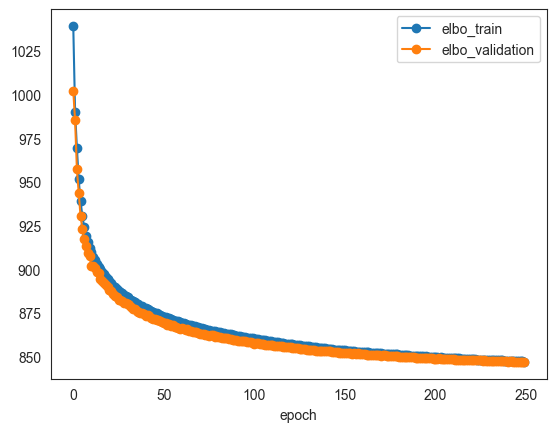

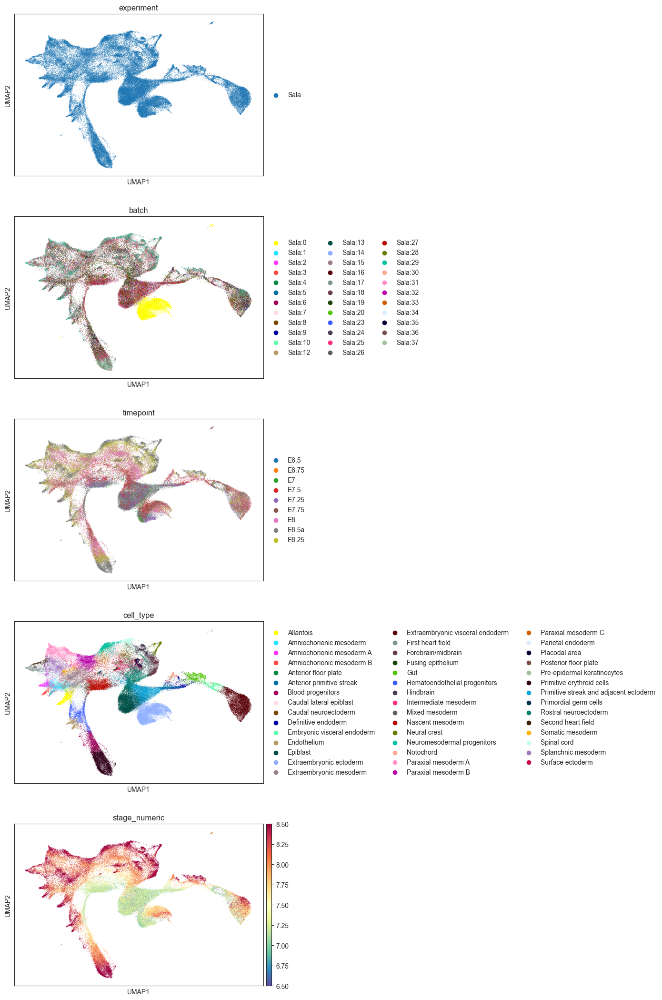

In [63]:
vae = scvi_scanvi_pipeline(ad, batch_key='batch')

In [ ]:
ad.obs['time_label'] = ad.obs['stage_numeric'].replace(dict(zip(np.sort(np.unique(ad.obs.stage_numeric)), range(len(np.unique(ad.obs.stage_numeric))))))

In [64]:

vae.save('../pygot_data/development/E6_5_8_5/scvi_model', overwrite=True)

In [65]:
sc.write('../pygot_data/development/E6_5_8_5/adata_processed.h5ad', ad)

## Flow model training

E0.5-E6.5 use scVI integration(key=batch), E6.5-E8.5 use rPCA integration (key=timepoint)

In [60]:
ad = sc.read('../pygot_data/development/E0_5_6_5/adata_processed.h5ad')

In [31]:
rm ../pygot_data/development/E0_5_6_5/scVI_path/ -rf

In [64]:
import pygot 
%matplotlib inline
# For E0.5-E6.5
# Too few cell in early stage, can not v-centric training
model, _ = pygot.tl.traj.fit_velocity_model(ad, embedding_key='X_scVI', time_key='stage_numeric', 
                                            path='../pygot_data/development/E0_5_6_5/scVI_path/',
                                            x_centric_batch_size=128, v_centric_batch_size=128, 
                                            linear=False,
                                            x_centric=True,
                                            n_neighbors=30,
                                            v_centric_iter_n=1000,
                                            x_centric_iter_n=2000,
                                            landmarks=False)

loading saved shortest path profile
[Errno 2] No such file or directory: '../pygot_data/development/E0_5_6_5/scVI_path//_0.0to1.0.pkl'
Error in loading shortest path file
calcu shortest path between 0.0 to 1.0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 4931.90it/s]


calcu shortest path between 1.0 to 2.0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 86/86 [00:00<00:00, 4695.40it/s]

calcu shortest path between 2.0 to 3.0



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 114/114 [00:00<00:00, 4471.04it/s]


calcu shortest path between 3.0 to 4.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 115/115 [00:00<00:00, 2359.24it/s]


calcu shortest path between 4.0 to 5.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 198/198 [00:00<00:00, 2686.79it/s]


calcu shortest path between 5.0 to 6.0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 87/87 [00:00<00:00, 1387.96it/s]


calcu shortest path between 6.0 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 995/995 [00:00<00:00, 1111.84it/s]


calcu shortest path between 7.0 to 8.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 343/343 [00:00<00:00, 2109.04it/s]


calcu shortest path between 8.0 to 9.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 331/331 [00:00<00:00, 1909.27it/s]


calcu shortest path between 9.0 to 10.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 464/464 [00:00<00:00, 1917.37it/s]


calcu shortest path between 10.0 to 11.0


loss :86.0038  best :85.4024: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [02:31<00:00, 13.24it/s]


In [65]:
torch.save(model, '../pygot_data/development/E0_5_6_5/got_scVI.pkl', )

In [56]:
ad = sc.read('../pygot_data/development/E6_5_8_5/adata_processed.h5ad')

In [67]:
!rm -rf ../pygot_data/development/E6_5_8_5/scVI_path

In [48]:
# For E6.5-E8.5
model, _ = pygot.tl.traj.fit_velocity_model(ad, embedding_key='X_scVI', time_key='stage_numeric', 
                                            path='../pygot_data/development/E6_5_8_5/scVI_path/',
                                            x_centric_batch_size=256, v_centric_batch_size=256,
                                            v_centric_iter_n=1000,
                                            x_centric_iter_n=2000,
                                            landmarks=False)

loading saved shortest path profile
[Errno 2] No such file or directory: '../pygot_data/development/E6_5_8_5/scVI_path//_6.5to6.75.pkl'
Error in loading shortest path file
calcu shortest path between 6.5 to 6.75


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3484/3484 [00:15<00:00, 226.44it/s]


calcu shortest path between 6.75 to 7.0


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2075/2075 [00:34<00:00, 60.40it/s]


calcu shortest path between 7.0 to 7.25


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14749/14749 [08:21<00:00, 29.40it/s]


calcu shortest path between 7.25 to 7.5


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13537/13537 [05:41<00:00, 39.65it/s]


calcu shortest path between 7.5 to 7.75


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10994/10994 [04:43<00:00, 38.76it/s]


calcu shortest path between 7.75 to 8.0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14493/14493 [08:20<00:00, 28.93it/s]


calcu shortest path between 8.0 to 8.25


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16681/16681 [10:05<00:00, 27.55it/s]


calcu shortest path between 8.25 to 8.5


loss :71.8209  best :70.8770: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:53<00:00,  8.57it/s]


loading saved shortest path profile


loss :71.7014  best :70.8199: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:52<00:00,  8.59it/s]


loading saved shortest path profile


loss :71.1360  best :70.5135: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:37<00:00,  9.18it/s]


loading saved shortest path profile


loss :71.1047  best :70.7673: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:55<00:00,  8.51it/s]


loading saved shortest path profile


loss :71.2371  best :70.4790: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:19<00:00, 10.02it/s]


loading saved shortest path profile


loss :71.4828  best :71.0502: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:53<00:00,  8.55it/s]


loading saved shortest path profile


loss :71.0098  best :70.2746: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:41<00:00,  9.02it/s]


loading saved shortest path profile


loss :71.1640  best :70.3590: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:52<00:00,  8.59it/s]


loading saved shortest path profile


loss :72.3099  best :71.4560: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:55<00:00,  8.50it/s]


loading saved shortest path profile


loss :71.1297  best :70.3954: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:53<00:00,  8.57it/s]


In [54]:
torch.save(model, '../pygot_data/development/E6_5_8_5/got_scVI.pkl', )

## Life roadmap inference

In [34]:
import pygot
import seaborn as sns
%matplotlib inline

### E0.5-E6.5

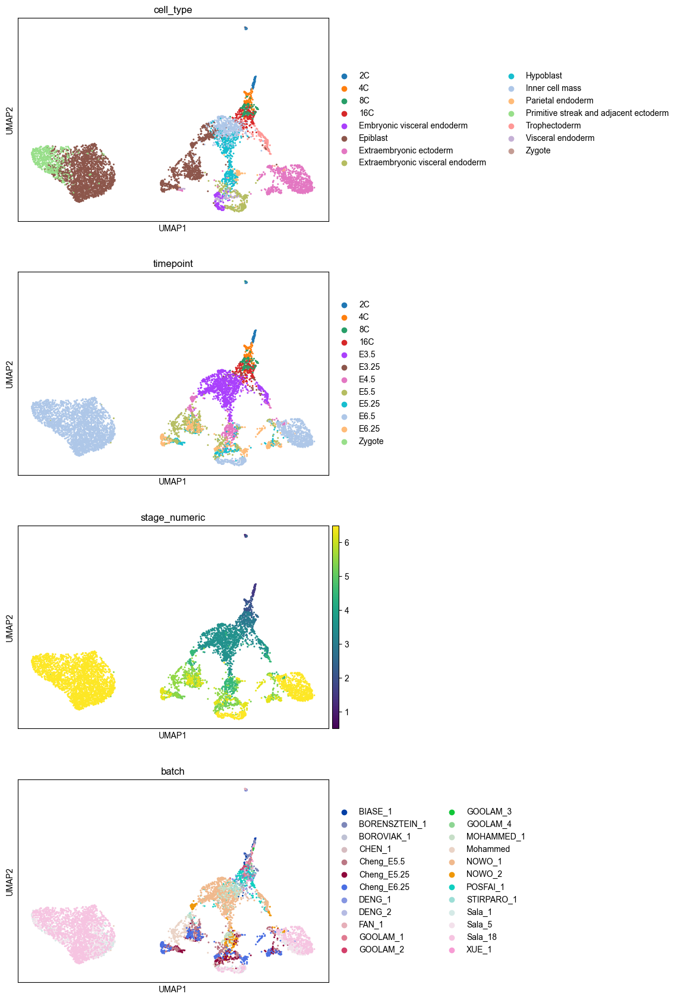

In [35]:
ad = sc.read('../pygot_data/development/E0_5_6_5/adata_processed.h5ad')
sc.pl.embedding(ad, color=['cell_type','timepoint', 'stage_numeric', 'batch'], basis='umap', ncols=1)
model = torch.load('../pygot_data/development/E0_5_6_5/got_scVI_8.pkl')
embedding_key = 'X_scVI'
velocity_key = 'velocity_scVI'
time_key = 'stage_numeric'
cell_type_key = 'cell_type'

In [41]:
ad.obsm[velocity_key] = pygot.tl.traj.latent_velocity(ad, model, embedding_key=embedding_key, time_key=time_key)

In [42]:
roadmap = pygot.tl.analysis.TimeSeriesRoadmap(ad, embedding_key, velocity_key, time_key, sde=True)
roadmap.compute_state_coupling(cell_type_key=cell_type_key,  n_neighbors=30)
filtered_back_state_coupling_list = roadmap.filter_state_coupling()

2025-04-30 17:18:45 	 Compute transition roadmap among [0.5  1.5  2.   2.5  3.   3.25 3.5  4.5  5.25 5.5  6.25 6.5 ]
2025-04-30 17:18:45 	 Compute transition between 0.5 and 1.5
2025-04-30 17:18:45 	 Compute velocity graph
Scale factor: 7.0274467
Scale factor: 7.0274467
2025-04-30 17:18:45 	 Convert into markov chain
2025-04-30 17:18:45 	 Solve abosorbing probabilities
2025-04-30 17:18:45 	 Generate NULL distribution
2025-04-30 17:18:45 	 Compute transition between 1.5 and 2.0
2025-04-30 17:18:45 	 Compute velocity graph
Scale factor: 6.475193
Scale factor: 6.475193
2025-04-30 17:18:45 	 Convert into markov chain
2025-04-30 17:18:45 	 Solve abosorbing probabilities
2025-04-30 17:18:45 	 Generate NULL distribution
2025-04-30 17:18:45 	 Compute transition between 2.0 and 2.5
2025-04-30 17:18:45 	 Compute velocity graph
Scale factor: 3.922813
Scale factor: 3.922813
2025-04-30 17:18:45 	 Convert into markov chain
2025-04-30 17:18:45 	 Solve abosorbing probabilities
2025-04-30 17:18:45 	 Ge

In [80]:
ts = np.sort(np.unique(ad.obs[time_key]))
summary, node_profile = summary_road_map(filtered_back_state_coupling_list, None, ts, cutoff=0.)

In [81]:
summary.to_csv('../pygot_data/development/road_map_edge_E0.5-E6.5_sde.csv', index=False)
node_profile.to_csv('../pygot_data/development/road_map_node_E0.5-E6.5_sde.csv', index=False)

### E6.5-E8.5

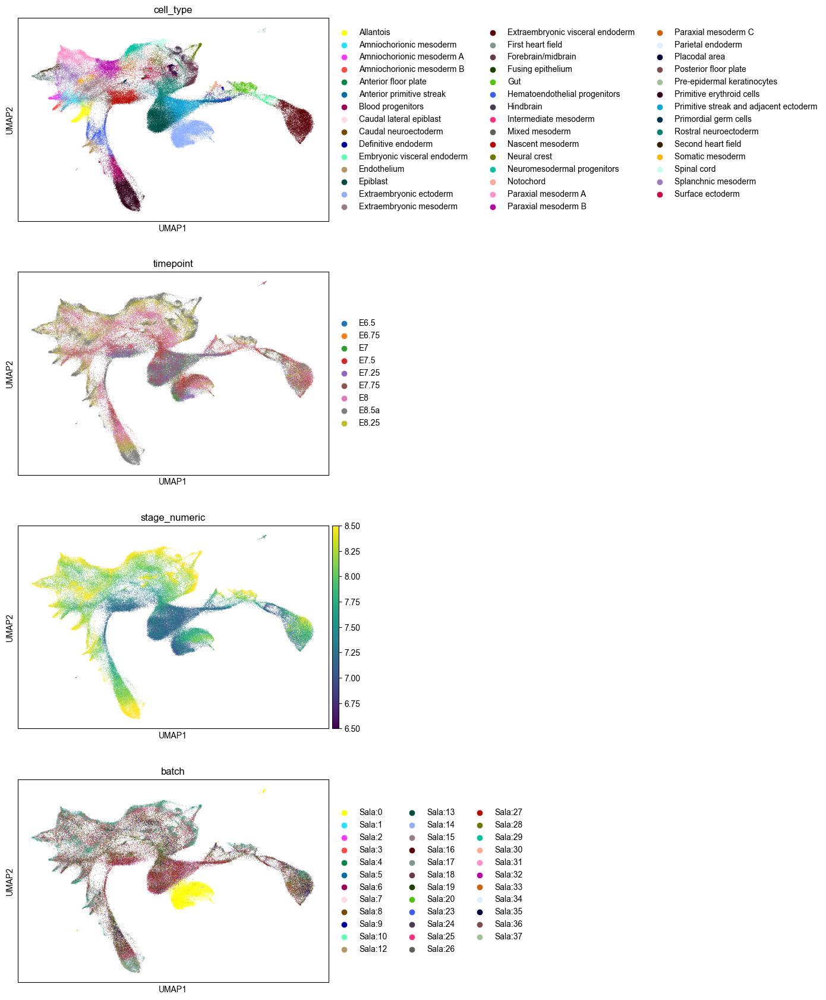

In [98]:
ad = sc.read('../pygot_data/development/E6_5_8_5/adata_processed.h5ad')
sc.pl.embedding(ad, color=['cell_type','timepoint', 'stage_numeric', 'batch'], basis='umap', ncols=1)
model = torch.load('../pygot_data/development/E6_5_8_5/got_scVI_1.pkl')
embedding_key = 'X_scVI'
velocity_key = 'velocity_scVI'
time_key = 'stage_numeric'
cell_type_key = 'cell_type'

In [99]:
ad.obsm[velocity_key] = pygot.tl.traj.latent_velocity(ad, model, embedding_key=embedding_key, time_key=time_key)

In [100]:
roadmap = pygot.tl.analysis.TimeSeriesRoadmap(ad, embedding_key, velocity_key, time_key, sde=True)
roadmap.compute_state_coupling(cell_type_key=cell_type_key, n_neighbors=30)
filtered_back_state_coupling_list = roadmap.filter_state_coupling()

2025-04-03 11:39:23 	 Compute transition roadmap among [6.5  6.75 7.   7.25 7.5  7.75 8.   8.25 8.5 ]
2025-04-03 11:39:23 	 Compute transition between 6.5 and 6.75
2025-04-03 11:39:28 	 Compute velocity graph
Scale factor: 0.64408255
Scale factor: 0.64408255
2025-04-03 11:39:37 	 Convert into markov chain
2025-04-03 11:39:37 	 Solve abosorbing probabilities
2025-04-03 11:39:38 	 Generate NULL distribution
2025-04-03 11:39:38 	 Compute transition between 6.75 and 7.0
2025-04-03 11:39:55 	 Compute velocity graph
Isolated node: 0.4517%
Scale factor: 0.59543467
Scale factor: 0.59543467
2025-04-03 11:40:03 	 Convert into markov chain
2025-04-03 11:40:03 	 Solve abosorbing probabilities
2025-04-03 11:40:10 	 Generate NULL distribution
2025-04-03 11:40:10 	 Compute transition between 7.0 and 7.25
2025-04-03 11:40:35 	 Compute velocity graph
Isolated node: 0.3995%
Scale factor: 0.6011108
Scale factor: 0.6011108
2025-04-03 11:40:52 	 Convert into markov chain
2025-04-03 11:40:52 	 Solve abosorb

In [101]:
# Modify Parietal endoderm because zero capture in E6.75
print(ad.obs.loc[ad.obs['cell_type'] == 'Parietal endoderm']['timepoint'].value_counts())
filtered_back_state_coupling_list[0].loc['Parietal endoderm'] = 0.

filtered_back_state_coupling_list[0]['Parietal endoderm'] = 0.
filtered_back_state_coupling_list[0].loc['Parietal endoderm', 'Parietal endoderm'] = 1.

filtered_back_state_coupling_list[1]['Parietal endoderm'] = 0.
filtered_back_state_coupling_list[1].loc['Parietal endoderm'] = 0.
filtered_back_state_coupling_list[1].loc['Parietal endoderm', 'Parietal endoderm'] = 1.


timepoint
E7       109
E7.25     89
E7.5      31
E8        25
E7.75     12
E6.5      11
E6.75      0
E8.5a      0
E8.25      0
Name: count, dtype: int64

In [102]:
ts = np.sort(np.unique(ad.obs[time_key]))
summary, node_profile = summary_road_map(filtered_back_state_coupling_list, None, ts, cutoff=0.)


In [76]:
summary.to_csv('../pygot_data/development/road_map_edge_E6.5-E8.5_sde.csv', index=False)
node_profile.to_csv('../pygot_data/development/road_map_node_E6.5-E8.5_sde.csv', index=False)

In [84]:
a = pd.read_csv('../pygot_data/development/road_map_edge_E0.5-E6.5_sde.csv')
b = pd.read_csv('../pygot_data/development/road_map_edge_E6.5-E8.5_sde.csv')

pd.concat([a,b]).to_csv('../pygot_data/development/road_map_edge_E0.5-E8.5_sde.csv', index=False)

In [85]:
a = pd.read_csv('../pygot_data/development/road_map_node_E0.5-E6.5_sde.csv')
b = pd.read_csv('../pygot_data/development/road_map_node_E6.5-E8.5_sde.csv')
res = pd.concat([a,b]).drop_duplicates(['cell_state', 'stage'])
res['x'] = res['stage'].replace(dict(zip(np.sort(np.unique(res['stage'])), range(len(np.sort(np.unique(res['stage'])))) )))
res.to_csv('../pygot_data/development/road_map_node_E0.5-E8.5_sde.csv', index=False)

## Some interest flow

### spinal cord lineage to hindbrain

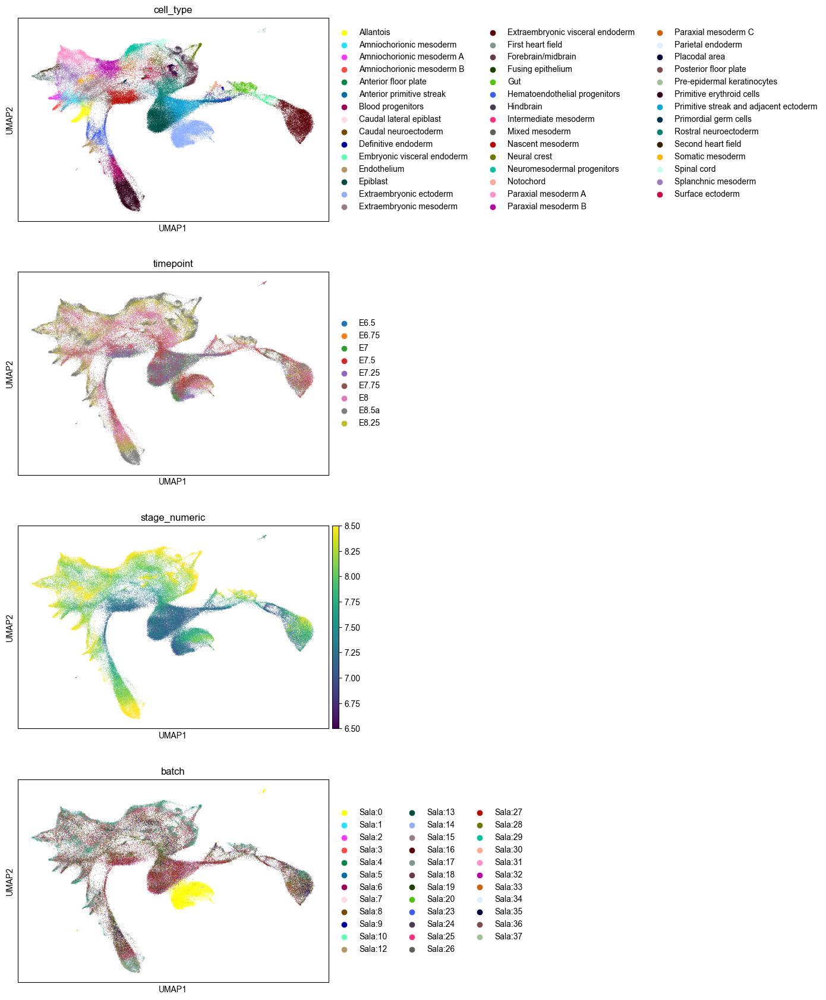

In [161]:
ad = sc.read('../pygot_data/development/E6_5_8_5/adata_processed.h5ad')
sc.pl.embedding(ad, color=['cell_type','timepoint', 'stage_numeric', 'batch'], basis='umap', ncols=1)
model = torch.load('../pygot_data/development/E6_5_8_5/got_scVI_1.pkl')

gene_meta = pd.read_table("../pygot_data/TOME/tome_code/help_code/mouse.v12.geneID.txt").set_index('gene_ID')
overlap_idx = ad.var.index.intersection(gene_meta.index)
ad.var['gene_name'] = ad.var.index
ad.var.loc[overlap_idx, 'gene_name'] = gene_meta.loc[overlap_idx]['gene_short_name']
ad.var = ad.var.set_index('gene_name')

In [162]:
ad_raw = ad.raw.to_adata()
gene_meta = pd.read_table("../pygot_data/TOME/tome_code/help_code/mouse.v12.geneID.txt").set_index('gene_ID')
overlap_idx = ad_raw.var.index.intersection(gene_meta.index)
ad_raw.var['gene_name'] = ad_raw.var.index
ad_raw.var.loc[overlap_idx, 'gene_name'] = gene_meta.loc[overlap_idx]['gene_short_name']
ad_raw.var = ad_raw.var.set_index('gene_name')

In [163]:
roadmap.adata = ad
roadmap.export_result()

Export result into adata.obsm['descendant'] and adata.obsm['ancestor']


In [164]:
vae = scvi.model.SCVI.load('../pygot_data/development/E6_5_8_5/scvi_model', ad )
inverse_transform = pygot.tl.traj.flow.get_inverse_transform_func_scVI(vae=vae, adata=ad)
ad.layers['velocity'] = pygot.tl.traj.velocity(ad, model, embedding_key='X_scVI', time_key='stage_numeric', dr_mode='nonlinear', inverse_transform=inverse_transform, dt=0.01)

INFO     File ../pygot_data/development/E6_5_8_5/scvi_model/model.pt already downloaded                            


In [165]:
pygot.tl.traj.velocity_graph(ad, embedding_key='X_scVI', velocity_key='velocity_scVI')


Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space


computing velocity embedding
    finished (0:00:32) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


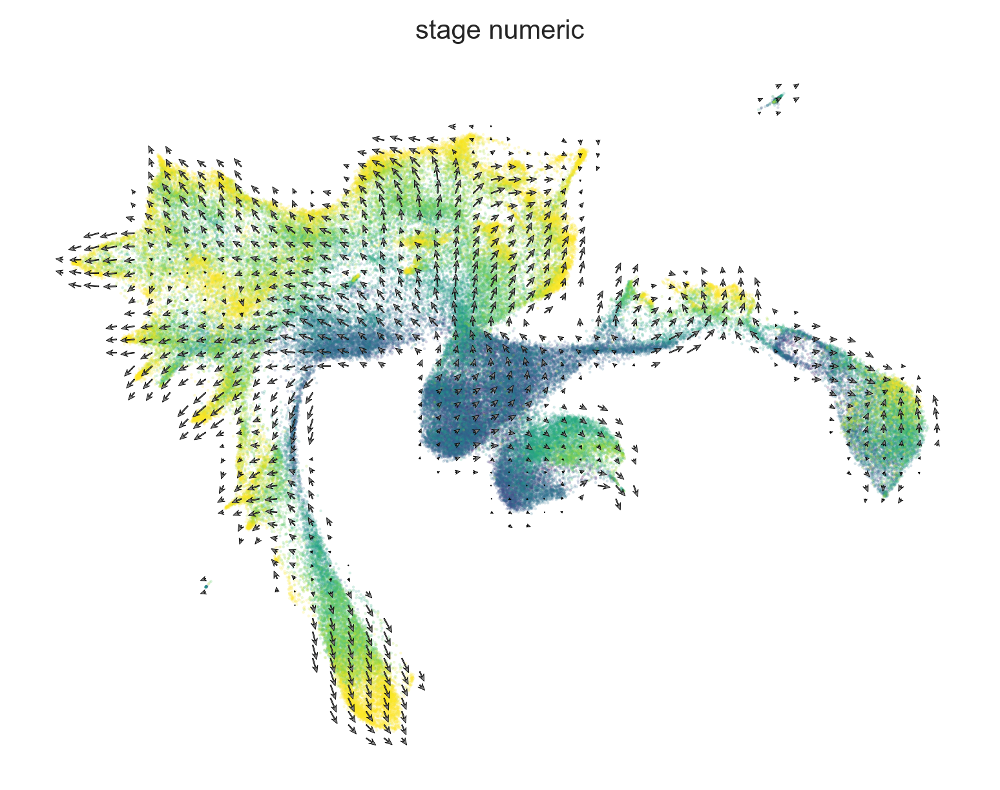

In [59]:
fig, ax = plt.subplots(1,1, dpi=300)
scv.pl.velocity_embedding_grid(ad, color='stage_numeric', legend_loc='none', ax=ax, arrow_length=1.5, arrow_size=1.2, colorbar=False, show=False)
plt.savefig('/disk/share/xuruihong/pygot_fig/development_E6.5_E8.5.pdf', format='pdf')

In [166]:
neuro_ad = ad[ad.obs['cell_type'].isin([
    
    'Spinal cord', 'Hindbrain', 'Rostral neuroectoderm', 
     'Forebrain/midbrain',
    'Caudal neuroectoderm',
])].copy()



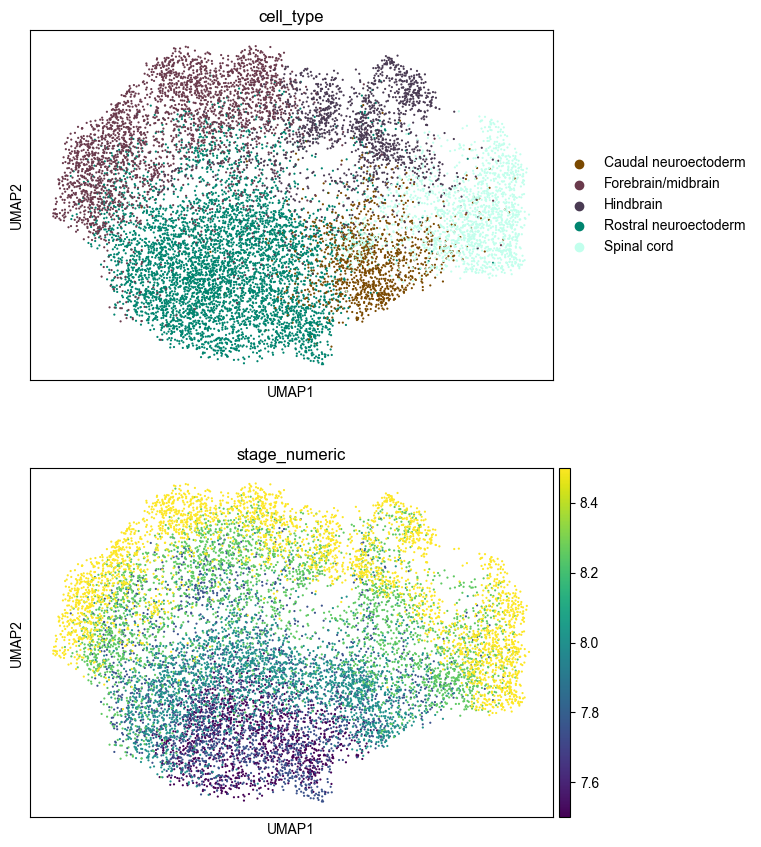

In [167]:
sc.pp.neighbors(neuro_ad, use_rep='X_scVI')
sc.tl.umap(neuro_ad)
sc.pl.umap(neuro_ad, color=['cell_type', 'stage_numeric'], ncols=1)

In [168]:
vae = scvi.model.SCVI.load('../pygot_data/development/E6_5_8_5/scvi_model', ad )
inverse_transform = pygot.tl.traj.flow.get_inverse_transform_func_scVI(vae=vae, adata=neuro_ad)
neuro_ad.layers['velocity'] = pygot.tl.traj.velocity(neuro_ad, model, embedding_key='X_scVI', time_key='stage_numeric', dr_mode='nonlinear', inverse_transform=inverse_transform, dt=0.01)

INFO     File ../pygot_data/development/E6_5_8_5/scvi_model/model.pt already downloaded                            


Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space
computing velocity embedding
    finished (0:00:03) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


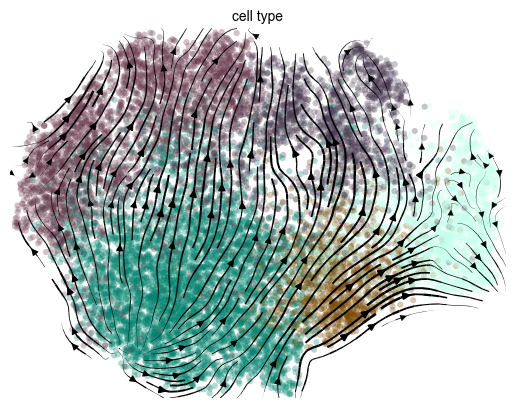

In [169]:
import scvelo as scv
pygot.tl.traj.velocity_graph(neuro_ad, embedding_key='X_scVI', velocity_key='velocity_scVI')
if 'velocity_umap' in neuro_ad.obsm.keys():
    del neuro_ad.obsm['velocity_umap']
scv.pl.velocity_embedding_stream(neuro_ad, color='cell_type', legend_loc='none')

In [170]:
neuro_ad_825 = neuro_ad[(neuro_ad.obs['stage_numeric'] >= 8.0) & (neuro_ad.obs['stage_numeric'] <= 8.25)]


In [171]:
neuro_ad_825.raw = ad_raw[neuro_ad_825.obs.index]

In [200]:
sc.pp.neighbors(neuro_ad_825, use_rep='X_scVI', )
sc.tl.umap(neuro_ad_825, min_dist=0.3 )
pygot.tl.traj.velocity_graph(neuro_ad_825, embedding_key='X_scVI', velocity_key='velocity_scVI')


Use adata.obsp['connectivities'] as neighbors, please confirm it is computed in embedding space


In [300]:
import mplscience
mplscience.set_style(reset_current=True)

plt.rcParams['font.sans-serif'] = ['Arial']

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


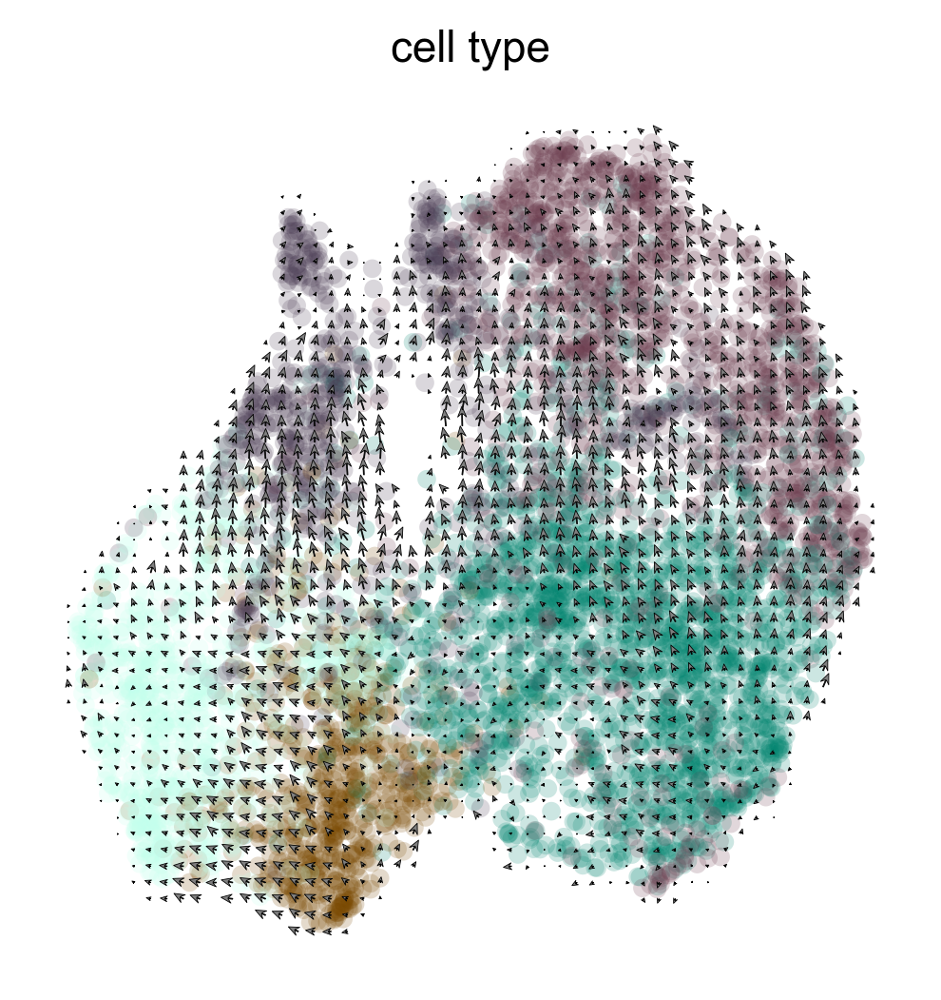

In [303]:
if 'velocity_umap' in neuro_ad_825.obsm:
    del neuro_ad_825.obsm['velocity_umap']
scv.pl.velocity_embedding_grid(neuro_ad_825, color='cell_type',  dpi=300, show=False, legend_loc='none', arrow_length=2, arrow_size=2)
plt.show()
#plt.savefig('/disk/share/xuruihong/pygot_fig/Hindbrain_velocity.pdf', format='pdf')

In [115]:
ad8 = ad[ad.obs[time_key].isin([8.0, 8.25])]

In [116]:
neuro_ad_825.layers['X_recon'] = vae.get_normalized_expression(neuro_ad_825)

INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        


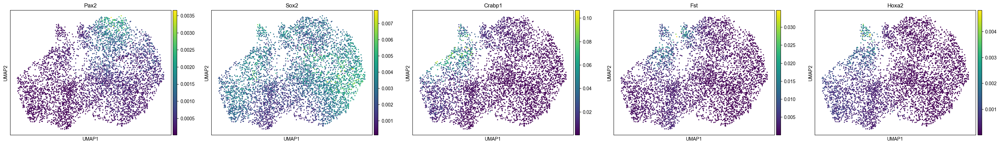

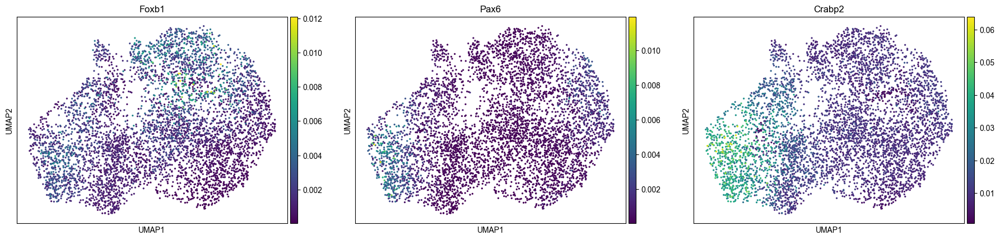

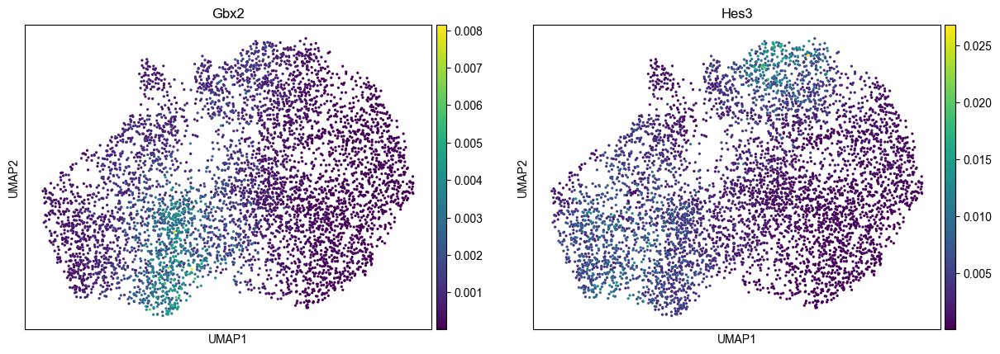

In [117]:
sc.pl.umap(neuro_ad_825, color=['Pax2', 'Sox2', 'Crabp1', 'Fst', 'Hoxa2'], use_raw=False, ncols=5, layer='X_recon')
sc.pl.umap(neuro_ad_825, color=['Foxb1', 'Pax6', 'Crabp2'], use_raw=False, ncols=5, layer='X_recon')
sc.pl.umap(neuro_ad_825, color=['Gbx2', 'Hes3'], use_raw=False, ncols=5, layer='X_recon')

In [207]:
hindbrain_825 = neuro_ad_825[neuro_ad_825[neuro_ad_825.obs['cell_type'] == 'Hindbrain'].obs.index].copy()

In [208]:
sc.pp.neighbors(hindbrain_825, use_rep='X_scVI')

In [209]:
hindbrain_825.obs['fate_bias'] = hindbrain_825.obsm['ancestor'][['Spinal cord', 'Caudal neuroectoderm']].sum(axis=1) / hindbrain_825.obsm['ancestor'][['Spinal cord',  'Rostral neuroectoderm', 'Caudal neuroectoderm']].sum(axis=1)

[<Axes: title={'center': 'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'fate_bias'}, xlabel='UMAP1', ylabel='UMAP2'>]

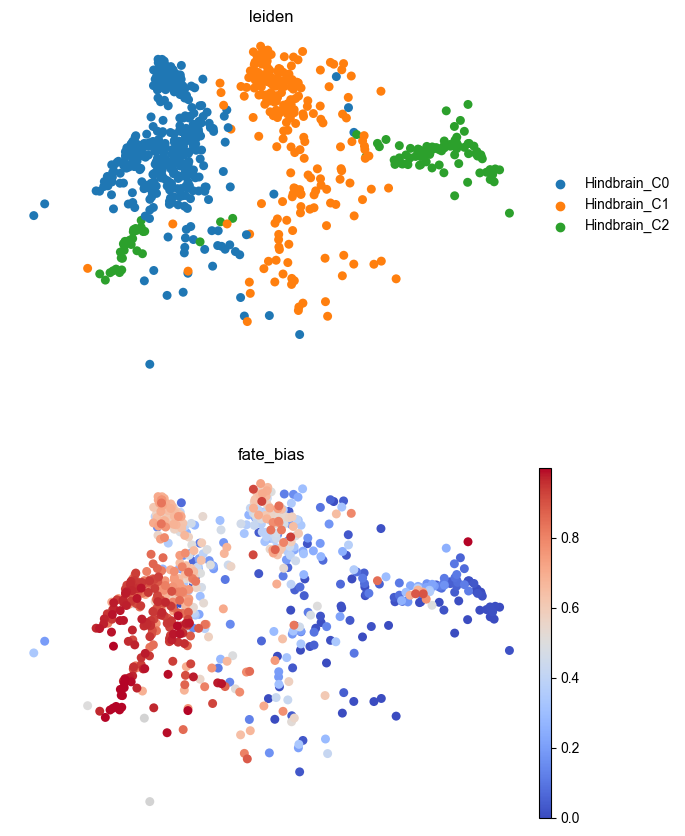

In [210]:
sc.tl.leiden(hindbrain_825, resolution=0.2)
hindbrain_825.obs['leiden'] = hindbrain_825.obs['leiden'].apply(lambda x: 'Hindbrain_C'+x)
sc.pl.umap(hindbrain_825, color=['leiden', 'fate_bias'], cmap='coolwarm', frameon=False ,ncols=1 , show=False)
#plt.savefig('/disk/share/xuruihong/pygot_fig/development_hindbrain_cluster.pdf', format='pdf')

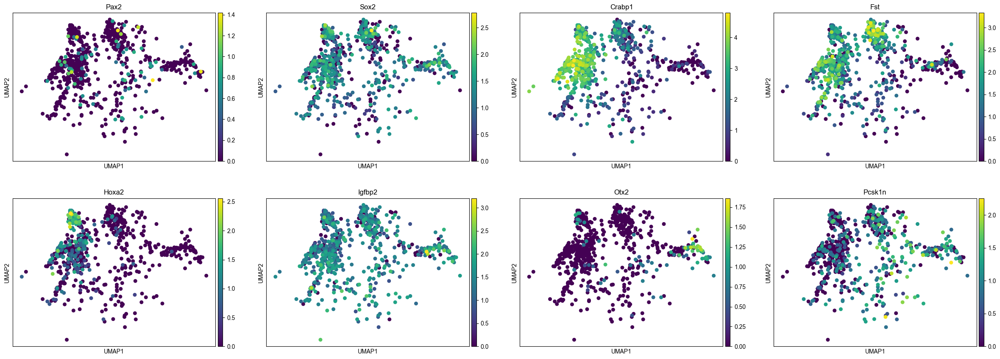

In [298]:
sc.pl.umap(hindbrain_825, color=['Pax2', 'Sox2', 'Crabp1', 'Fst', 'Hoxa2','Igfbp2', 'Otx2', 'Pcsk1n'], use_raw=False)

In [211]:
hindbrain_825.obs['subtype'] = 'Uncertain'
hindbrain_825.obs.loc[hindbrain_825.obs['fate_bias'] > 0.7, 'subtype'] = 'from Caudal neuroectoderm'
hindbrain_825.obs.loc[hindbrain_825.obs['fate_bias'] < 0.3, 'subtype'] = 'from Rostral neuroectoderm'

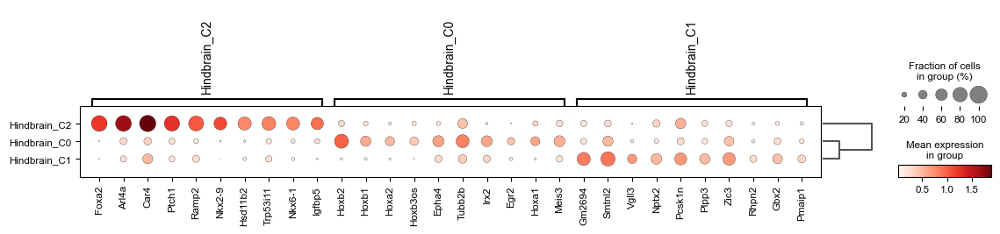

In [213]:
hindbrain_825.uns['log1p']['base'] = None
sc.tl.dendrogram(hindbrain_825, use_rep='X_scVI', groupby='leiden')
sc.tl.rank_genes_groups(hindbrain_825, groupby='leiden', use_raw=False)

sc.tl.filter_rank_genes_groups(hindbrain_825, min_in_group_fraction=0.25, max_out_group_fraction=0.5)

#sc.pl.rank_genes_groups_dotplot(mature_endo_adata, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(hindbrain_825, key='rank_genes_groups_filtered',   use_raw=False)

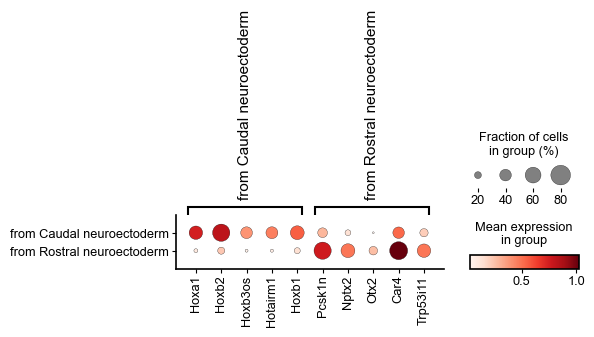

In [306]:
bias_ad = hindbrain_825[hindbrain_825.obs['subtype'] != 'Uncertain']
bias_ad.obs['subtype'] = pd.Categorical(bias_ad.obs['subtype'])
sc.tl.dendrogram(bias_ad, use_rep='X_scVI', groupby='subtype')
sc.tl.rank_genes_groups(bias_ad, groupby='subtype', use_raw=False)

sc.tl.filter_rank_genes_groups(bias_ad, min_in_group_fraction=0.25, max_out_group_fraction=0.5)

#sc.pl.rank_genes_groups_dotplot(mature_endo_adata, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(bias_ad , key='rank_genes_groups_filtered', n_genes=5,  use_raw=False, show=False)
plt.show()
#plt.savefig('/disk/share/xuruihong/pygot_fig/hindbrain_DEG.pdf', format='pdf')

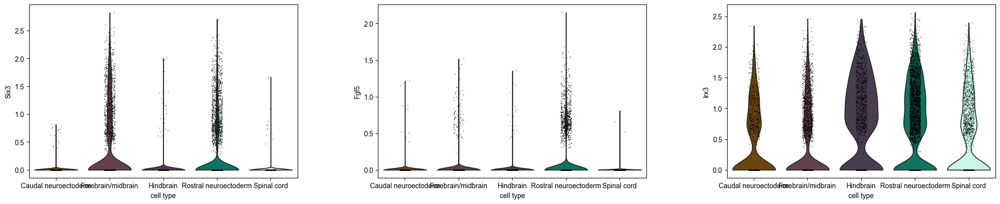

In [281]:

sc.pl.violin(neuro_ad, ['Six3', 'Fgf5', 'Irx3'],groupby='cell_type', use_raw=False)

In [195]:
neuro_ad_825.obs['cell_type_level2'] = neuro_ad_825.obs['cell_type'].astype(str)
for c in hindbrain_825.obs.leiden.unique():
    neuro_ad_825.obs.loc[hindbrain_825.obs.loc[hindbrain_825.obs.leiden == c].index.intersection(neuro_ad_825.obs.index), 'cell_type_level2'] = c

In [196]:
neuro_ad_825.obs['cell_type_level3'] = neuro_ad_825.obs['cell_type'].astype(str)
for c in hindbrain_825.obs.subtype.unique():
    neuro_ad_825.obs.loc[hindbrain_825.obs.loc[hindbrain_825.obs.subtype == c].index.intersection(neuro_ad_825.obs.index), 'cell_type_level3'] = c

In [74]:
#C2 midbrain-hindbrain boundary 
#marker: Nkx6-1, Arl4a
#citation: 
#https://www.researchgate.net/profile/Li-Ma-98/publication/235669705_Xenopus_Nkx61_and_Nkx62_are_required_for_mid-hindbrain_boundary_development/links/0c96052dda1b58d21d000000/Xenopus-Nkx61-and-Nkx62-are-required-for-mid-hindbrain-boundary-development.pdf
#https://www.jbc.org/article/S0021-9258(20)88493-2/fulltext ARL4, an ARF-like protein that is developmentally regulated and localized to nuclei and nucleoli. 

In [75]:
#C1 hindbrain-spinal coral boundary
#marker: Fgf3
#citation: 
#https://www.researchgate.net/profile/Li-Ma-98/publication/235669705_Xenopus_Nkx61_and_Nkx62_are_required_for_mid-hindbrain_boundary_development/links/0c96052dda1b58d21d000000/Xenopus-Nkx61-and-Nkx62-are-required-for-mid-hindbrain-boundary-development.pdf
#https://www.jbc.org/article/S0021-9258(20)88493-2/fulltext ARL4, an ARF-like protein that is developmentally regulated and localized to nuclei and nucleoli. 

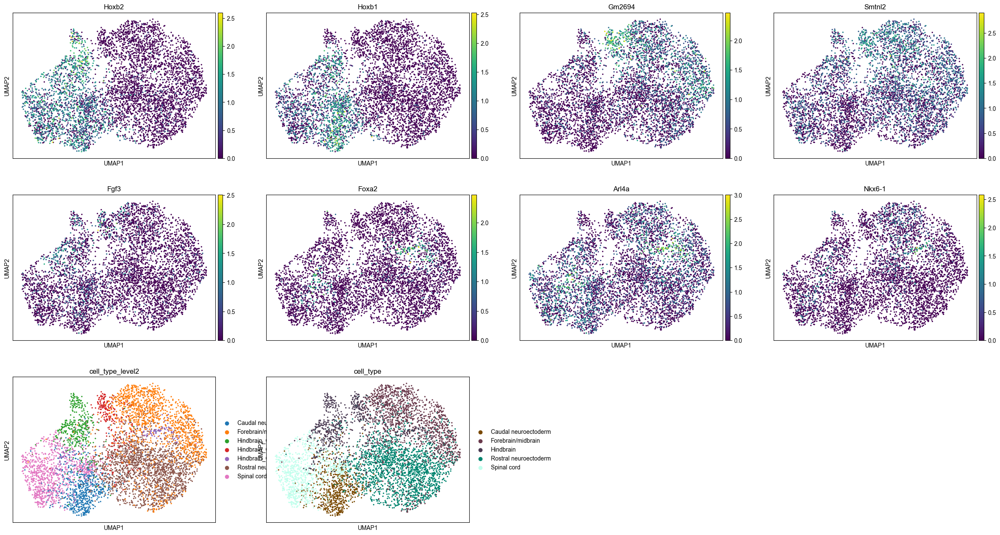

In [198]:
sc.pl.umap(neuro_ad_825, color=['Hoxb2','Hoxb1', 'Gm2694', 'Smtnl2', 'Fgf3', 
                                'Foxa2', 'Arl4a','Nkx6-1', 
                                'cell_type_level2',  'cell_type'] ,)

... storing 'hindbrain_subtype' as categorical


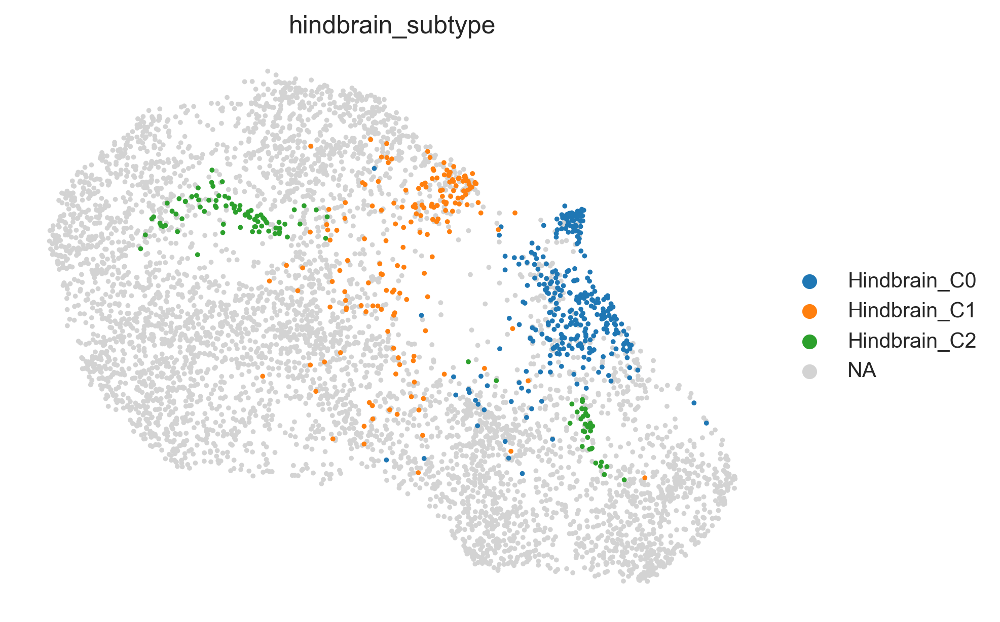

In [141]:
fig, ax = plt.subplots(1,1,dpi=300)
sc.pl.umap(neuro_ad_825, color=['hindbrain_subtype'] , frameon=False, ax=ax)

### ST data

#### E8.5 gas altas

In [214]:
sdata_85 = sc.read('../pygot_data/development/ST/E8.5.h5ad')
sc.pp.normalize_total(sdata_85)
sc.pp.log1p(sdata_85)
meta = pd.read_csv('../pygot_data/development/ST/E8.5_meta.txt', sep='\t', ).set_index('cell')
sdata_85.obs['celltype'] = meta.loc[sdata_85.obs.index]['celltype']
xyz = pd.read_csv('../pygot_data/development/ST/E8.5_coord.txt', sep='\t', )
sdata_85.obsm['spatial'] = xyz.loc[sdata_85.obs.index].to_numpy()
sdata_85.obsm['spatial'][:,1] = -sdata_85.obsm['spatial'][:,1]
sdata_85.var = sdata_85.var.set_index('SYMBOL')

In [215]:
embryo='embryo2'

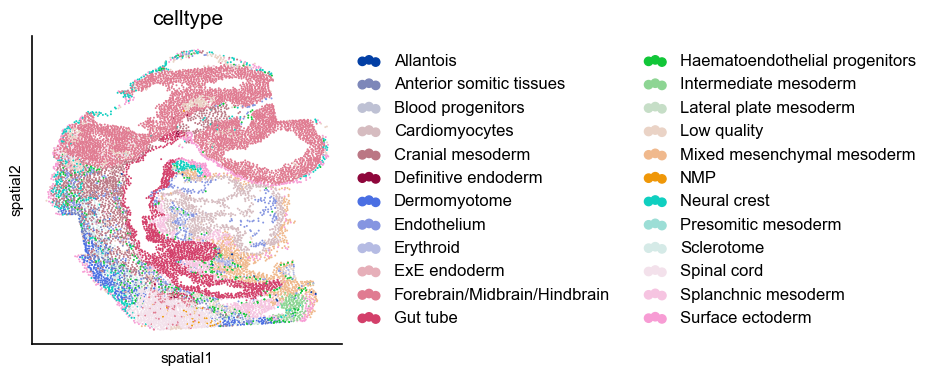

In [344]:

fig, ax = plt.subplots(1,1)
sc.pl.embedding(sdata_85[(sdata_85.obs['orig.ident'] == embryo)],
                basis='spatial', color='celltype', ncols=1, ax=ax, show=False,  )
plt.savefig('/disk/share/xuruihong/pygot_fig/st85.jpg', format='jpg', dpi=300)
plt.show()

#### E9.5 

In [217]:
st_adata_slide = sc.read('../pygot_data/development/ST/Slideseq.h5ad')

In [218]:
st_adata_95 = st_adata_slide[st_adata_slide.obs['orig.ident'] == '201104_33']

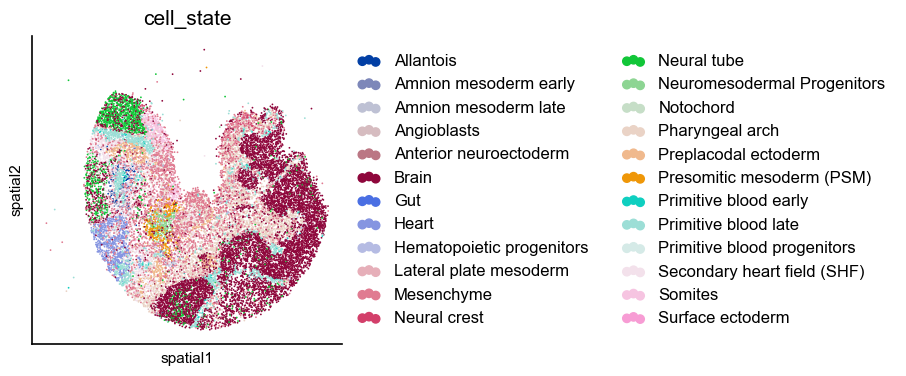

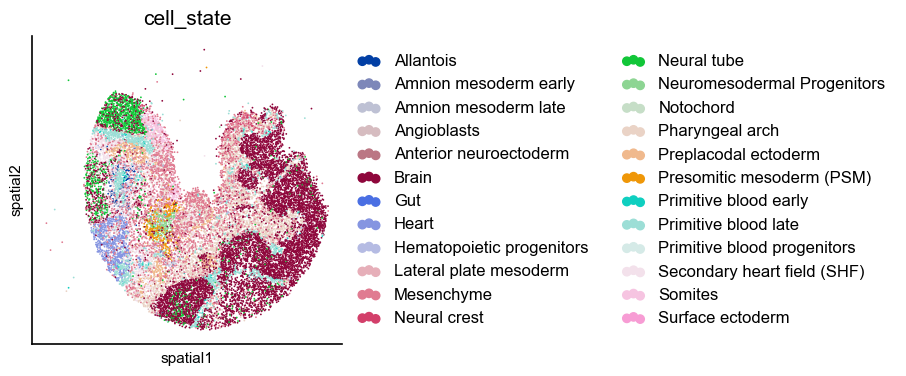

In [339]:
sc.pl.embedding(st_adata_95, color='cell_state', basis='spatial', show=False)
plt.savefig('/disk/share/xuruihong/pygot_fig/st95.jpg', format='jpg', dpi=300)
plt.show()

In [220]:
st_brain_idx = sc.read('../pygot_data/development/ST/E9.5_brain.h5ad').obs
st_brain = st_adata_95[st_brain_idx.index]

In [221]:
#st_brain = st_adata_slide[st_adata_slide.obs['orig.ident'] == '201104_33']
#st_brain = st_brain[st_brain.obs['cell_type'].isin(['midbrain dopaminergic neuron', 'spinal cord interneuron'])]

In [222]:
from sklearn.cluster import DBSCAN
st_brain.obs['dbscan'] = DBSCAN(eps=60, min_samples=50).fit_predict(st_brain.obsm['spatial'])
#st_brain.obs['dbscan'] = DBSCAN(eps=100, min_samples=100).fit_predict(st_brain.obsm['spatial'])


In [223]:
flag = (st_brain.obs['dbscan'].isin([0, 2, 3, 4])) | (st_brain.obsm['spatial'][:,1] > 2100)

In [224]:
st_brain = st_brain[flag]

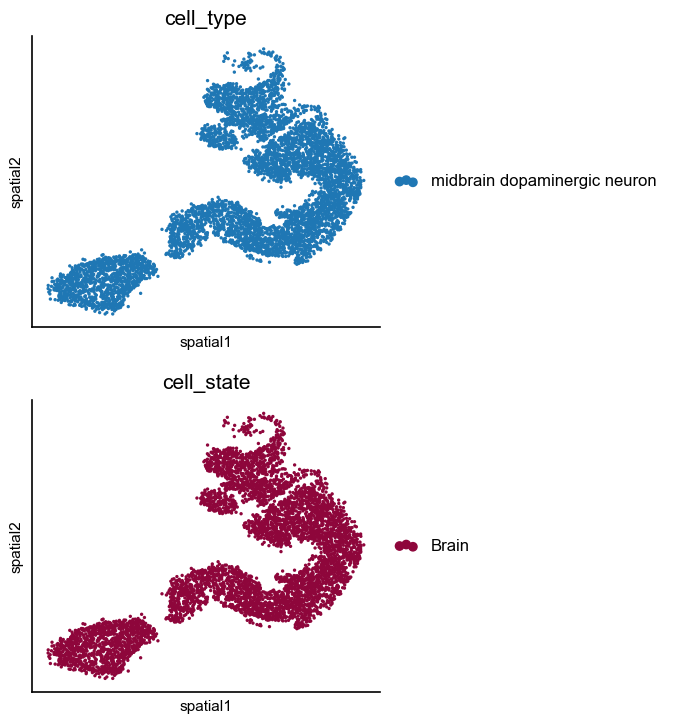

In [335]:
sc.pl.embedding(st_brain, basis='spatial', color=['cell_type', 'cell_state'], ncols=1)

### ST deconvolution

positive control to make sure the power of deconvolution methods

In [229]:
ad.uns['log1p']['base'] = None

In [230]:
adata_sc = ad[ad.obs['stage_numeric'] == 8.5]
cell_type_key = 'cell_type'
sc.tl.rank_genes_groups(adata_sc, groupby=cell_type_key, use_raw=False)

markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))
len(markers)

1141

In [231]:
embryo = 'embryo2'
adata_st = sdata_85[(sdata_85.obs['orig.ident'] == embryo)]

In [232]:
import tangram as tg
tg.pp_adatas(adata_sc, adata_st, genes=markers)

INFO:root:229 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:293 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [233]:
ad_map = tg.map_cells_to_space(adata_sc, adata_st,
    mode='clusters',
#     mode="clusters",
    cluster_label=cell_type_key,  # .obs field w cell types
    density_prior='rna_count_based',
    num_epochs=500,
    device="cuda",
   
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 229 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.379, KL reg: 0.060
Score: 0.600, KL reg: 0.001
Score: 0.601, KL reg: 0.001
Score: 0.602, KL reg: 0.001
Score: 0.602, KL reg: 0.001


INFO:root:Saving results..


In [234]:
tg.project_cell_annotations(ad_map, adata_st, annotation=cell_type_key)
annotation_list = list(pd.unique(adata_sc.obs[cell_type_key]))

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


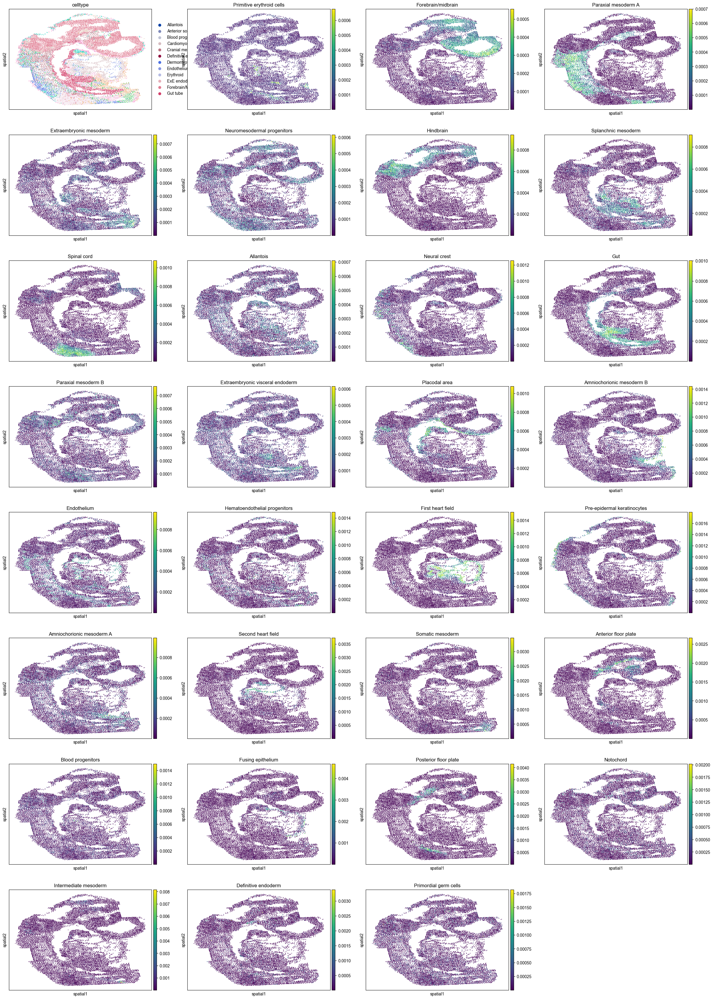

In [235]:
adata_st.obs[adata_st.obsm['tangram_ct_pred'].columns] = adata_st.obsm['tangram_ct_pred']
sc.pl.embedding(adata_st, basis='spatial', color=['celltype'] + list(adata_st.obsm['tangram_ct_pred'].columns))

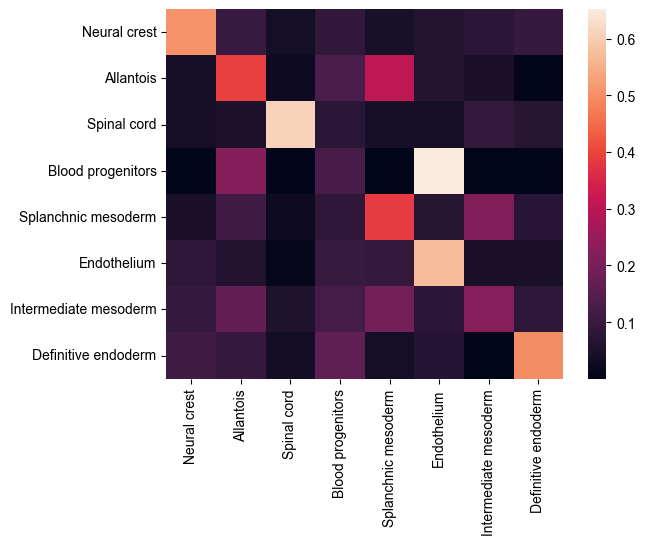

In [236]:
import seaborn as sns
overlap_cell_type = pd.Index(adata_sc.obs[cell_type_key].unique()).intersection(adata_st.obs['celltype'])
positive_control = adata_st.obs.loc[adata_st.obs['celltype'].isin(overlap_cell_type)]
scores = []
for c in overlap_cell_type:
    scores.append(positive_control.loc[positive_control['celltype'] == c][overlap_cell_type].mean().to_numpy())
scores = np.array(scores)
scores /= scores.sum(axis=1)[:,None]
plt.subplots(1,1)
sns.heatmap(pd.DataFrame(scores, index=overlap_cell_type, columns=overlap_cell_type),)
#plt.savefig('/disk/share/xuruihong/pygot_fig/deconv_positive_control.pdf', format='pdf')

### Deconv E8.5

In [348]:
tobe_deconv = neuro_ad_825.obs.loc[neuro_ad_825.obs['cell_type'].isin(['Forebrain/midbrain', 'Hindbrain'])]

In [349]:
adata_sc = ad_raw[tobe_deconv.index].copy()
adata_sc.obs = tobe_deconv
cell_type_key = 'cell_type_level2'
adata_sc.obs[cell_type_key] = adata_sc.obs[cell_type_key].astype(str)
adata_sc = adata_sc[adata_sc.obs[cell_type_key] != 'Hindbrain']
sc.pp.filter_genes(adata_sc, min_cells=3)
sc.tl.rank_genes_groups(adata_sc, groupby=cell_type_key, use_raw=False)
adata_sc.var_names_make_unique()
sc.tl.filter_rank_genes_groups(adata_sc, min_in_group_fraction=0.25, max_out_group_fraction=0.5)


In [350]:
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))
len(markers)

364

In [351]:
adata_sc.var_names_make_unique()

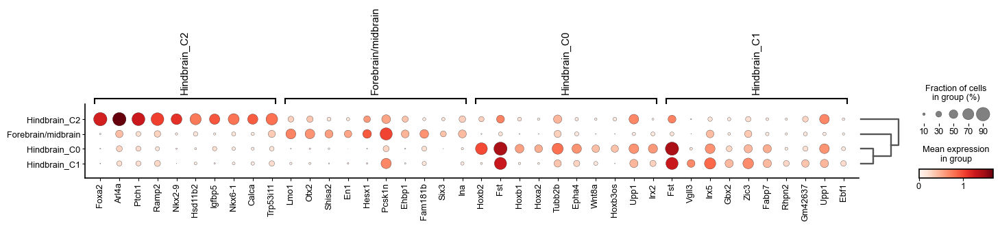

In [352]:
sc.tl.dendrogram(adata_sc, groupby=cell_type_key, use_rep='X_scVI')
sc.pl.rank_genes_groups_dotplot(adata_sc, key='rank_genes_groups_filtered', use_raw=False)

In [353]:
embryo = 'embryo2'

In [354]:
adata_st = sdata_85[(sdata_85.obs['orig.ident'] == embryo)
& (sdata_85.obs['celltype'].isin(['Forebrain/Midbrain/Hindbrain']))].copy()

In [355]:
import tangram as tg
tg.pp_adatas(adata_sc, adata_st, genes=markers)

INFO:root:47 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:327 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [356]:
ad_map = tg.map_cells_to_space(adata_sc, adata_st,
    mode="clusters",
    cluster_label=cell_type_key,  # .obs field w cell types
    density_prior='rna_count_based',
    num_epochs=500,
    device="cuda",
   
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 47 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.397, KL reg: 0.251
Score: 0.611, KL reg: 0.003
Score: 0.612, KL reg: 0.003
Score: 0.613, KL reg: 0.003
Score: 0.613, KL reg: 0.003


INFO:root:Saving results..


In [357]:
tg.project_cell_annotations(ad_map, adata_st, annotation=cell_type_key)
annotation_list = list(pd.unique(adata_sc.obs[cell_type_key]))

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [358]:
adata_st.obs[adata_st.obsm['tangram_ct_pred'].columns] = adata_st.obsm['tangram_ct_pred'].to_numpy() / adata_st.obsm['tangram_ct_pred'].to_numpy().sum(axis=1)[:,None]

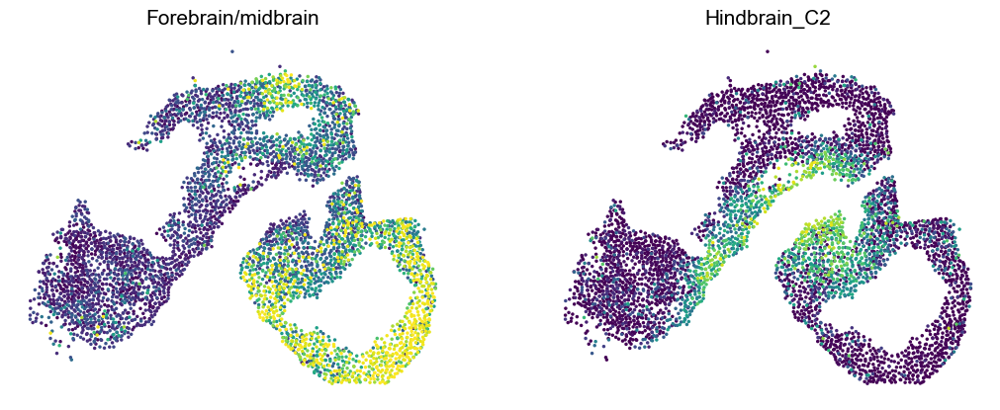

In [364]:
fig, axes = plt.subplots(1,2, figsize=(6.4*2, 4.8))
adata_show = adata_st[(adata_st.obsm['spatial'][:,0] < 2.) & (adata_st.obsm['spatial'][:,1] > 0.2)]
sc.pl.embedding(adata_show, basis='spatial', color=['Forebrain/midbrain'] , ax=axes[0], frameon=False, colorbar_loc=None, show=False)
sc.pl.embedding(adata_show, basis='spatial', color=['Hindbrain_C2'] , ax=axes[1], frameon=False, colorbar_loc=None, show=False)

plt.savefig('/disk/share/xuruihong/pygot_fig/hindbrain_deconv_E8.5.jpg', format='jpg', dpi=300)
plt.show()

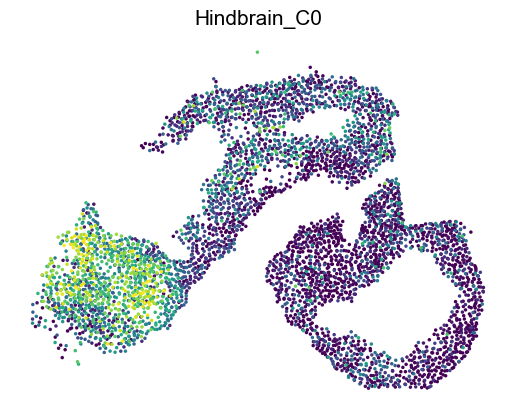

In [368]:
fig, ax = plt.subplots(1,1, figsize=(6.4, 4.8))
adata_show = adata_st[(adata_st.obsm['spatial'][:,0] < 2.) & (adata_st.obsm['spatial'][:,1] > 0.2)]
sc.pl.embedding(adata_show, basis='spatial', color=['Hindbrain_C0'] , ax=ax, frameon=False, colorbar_loc=None, show=False)
plt.savefig('/disk/share/xuruihong/pygot_fig/hindbrain_deconv_E8.5_C0.jpg', format='jpg', dpi=300)
plt.show()

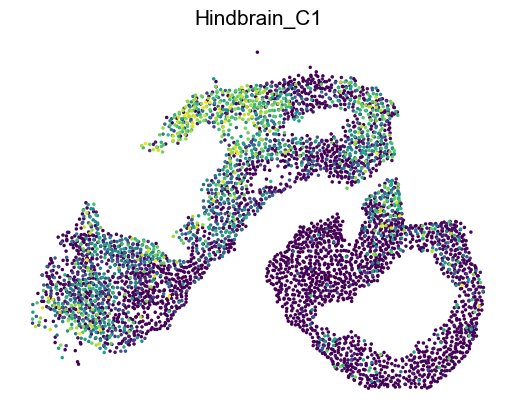

In [369]:
fig, ax = plt.subplots(1,1, figsize=(6.4, 4.8))
adata_show = adata_st[(adata_st.obsm['spatial'][:,0] < 2.) & (adata_st.obsm['spatial'][:,1] > 0.2)]
sc.pl.embedding(adata_show, basis='spatial', color=['Hindbrain_C1'] , ax=ax, frameon=False, colorbar_loc=None, show=False)
plt.savefig('/disk/share/xuruihong/pygot_fig/hindbrain_deconv_E8.5_C1.jpg', format='jpg', dpi=300)
plt.show()

### Deconv E9.5

In [370]:
import tangram as tg
adata_st = st_brain
try:
    adata_st.var = adata_st.var.set_index('feature_name')
except:
    pass
tg.pp_adatas(adata_sc, adata_st, genes=markers)

INFO:root:343 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:13520 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [371]:
ad_map = tg.map_cells_to_space(adata_sc, adata_st,
    
    mode="clusters",
    cluster_label=cell_type_key,  # .obs field w cell types
    density_prior='rna_count_based',
    num_epochs=500,
    device="cuda",
   
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 343 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.255, KL reg: 0.323
Score: 0.393, KL reg: 0.001
Score: 0.394, KL reg: 0.001
Score: 0.395, KL reg: 0.001
Score: 0.395, KL reg: 0.001


INFO:root:Saving results..


In [372]:
tg.project_cell_annotations(ad_map, adata_st, annotation=cell_type_key)
annotation_list = list(pd.unique(adata_sc.obs[cell_type_key]))

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [373]:
adata_st.obs[adata_st.obsm['tangram_ct_pred'].columns] = adata_st.obsm['tangram_ct_pred'].to_numpy() / adata_st.obsm['tangram_ct_pred'].to_numpy().sum(axis=1)[:,None]

In [374]:
adata_st.obs['fate_bias'] = adata_st.obs['Hindbrain_C0'] / (adata_st.obs['Hindbrain_C0'] + adata_st.obs['Hindbrain_C1'])

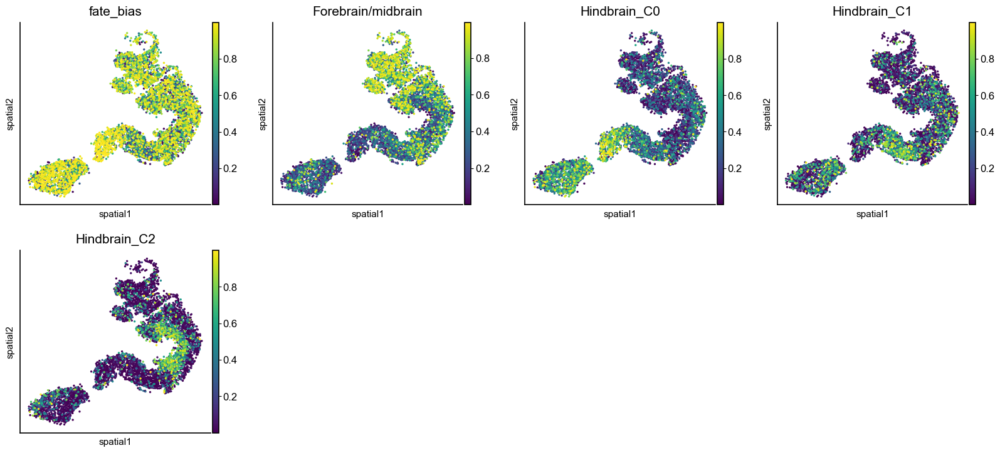

In [375]:
sc.pl.embedding(adata_st, basis='spatial', color=['fate_bias', ] +  list(adata_st.obsm['tangram_ct_pred'].columns))

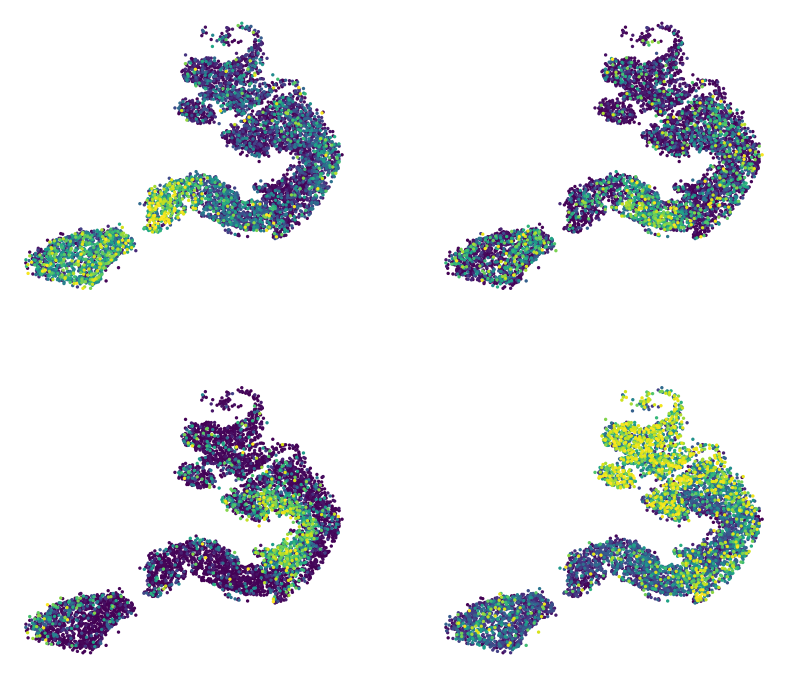

In [380]:

sc.pl.embedding(adata_st, basis='spatial', color=['Hindbrain_C0', 'Hindbrain_C1', 'Hindbrain_C2', 'Forebrain/midbrain'] , title=['', '','',''], frameon=False, ncols=2, colorbar_loc=None, show=False)

plt.savefig('/disk/share/xuruihong/pygot_fig/hindbrain_deconv_E9.5.jpg', format='jpg', dpi=300)
plt.show()